# Import Required Libraries
Import the necessary libraries, including NumPy, pandas, and matplotlib.

In [1]:
# Import Required Libraries
import sys
sys.path.append('../edaf')
from plot_helpers import *
from data_helpers import *
import seaborn as sns
from decomp import *
from sortedcontainers import SortedList, SortedDict
from loguru import logger
import os, sys, gzip, json
import sqlite3
import pandas as pd
from edaf.core.uplink.preprocess import preprocess_ul
from edaf.core.uplink.analyze_packet import ULPacketAnalyzer
from edaf.core.uplink.analyze_channel import ULChannelAnalyzer
from edaf.core.uplink.analyze_scheduling import ULSchedulingAnalyzer
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from IPython.display import JSON
from pathlib import Path
import ijson
import numpy as np

# Configure seaborn
sns.set_theme(style='darkgrid')
sns.set()

# Configure logger
logger.remove()
logger.add(sys.stdout, level="ERROR")

# Enable autoreload
%load_ext autoreload
%autoreload 2

# Initialize Paths for Multiple Measurements
Initialize paths for multiple measurements (e.g., s60 and s61) and set up directories for plots and data.

In [1]:
# Initialize Paths for Multiple Measurements

# Define measurement labels
MEAS_LABELS = ['s69' ,'s70' ,'s71' ,'s72' ,'s73' ,'s74' ,'s75' ,'s76' , 's77']

# Initialize paths for each measurement
paths = {}
for label in MEAS_LABELS:
    paths[label] = {
        'DB_FILE': f'/home/ahmad/Desktop/RA-5G/measurements/{label}/res_db.sql',
        'PLOTS_DIR': f'./plots/{label}/',
        'DATA_DIR': f'./data/{label}/'
    }

# Create directories if they do not exist
for label in MEAS_LABELS:
    os.makedirs(paths[label]['PLOTS_DIR'], exist_ok=True)
    os.makedirs(paths[label]['DATA_DIR'], exist_ok=True)

IMPORT_FROM_JSON=True
# Display the paths dictionary
paths

NameError: name 'os' is not defined

# Load and Analyze Data for Each Measurement
Load data from JSON files or databases for each measurement and perform analysis using the analyzers.

RNTIs in packets: ['e595']
2025-01-16 20:50:25.142 | ERROR    | decomp:get_tx_delay:166 - Packet 79832 phy.in_t or phy.in_t not present
2025-01-16 20:50:25.143 | ERROR    | decomp:get_tx_delay:166 - Packet 79832 phy.in_t or phy.in_t not present
2025-01-16 20:50:25.144 | ERROR    | decomp:get_tx_delay:166 - Packet 79822 phy.in_t or phy.in_t not present
2025-01-16 20:50:25.144 | ERROR    | decomp:get_tx_delay:166 - Packet 79822 phy.in_t or phy.in_t not present
2025-01-16 20:50:25.144 | ERROR    | decomp:get_tx_delay:166 - Packet 79808 phy.in_t or phy.in_t not present
2025-01-16 20:50:25.145 | ERROR    | decomp:get_tx_delay:166 - Packet 79808 phy.in_t or phy.in_t not present
2025-01-16 20:50:25.146 | ERROR    | decomp:get_tx_delay:166 - Packet 79786 phy.in_t or phy.in_t not present
2025-01-16 20:50:25.146 | ERROR    | decomp:get_tx_delay:166 - Packet 79786 phy.in_t or phy.in_t not present
2025-01-16 20:50:25.146 | ERROR    | decomp:get_tx_delay:166 - Packet 79784 phy.in_t or phy.in_t not 

/tmp/ipykernel_56599/2202462470.py:121: MatplotlibDeprecationWarning: The 'use_line_collection' parameter of stem() was deprecated in Matplotlib 3.6 and will be removed two minor releases later. If any parameter follows 'use_line_collection', they should be passed as keyword, not positionally.
  plt.stem(range(max_lag + 1), autocorr_values, use_line_collection=True)


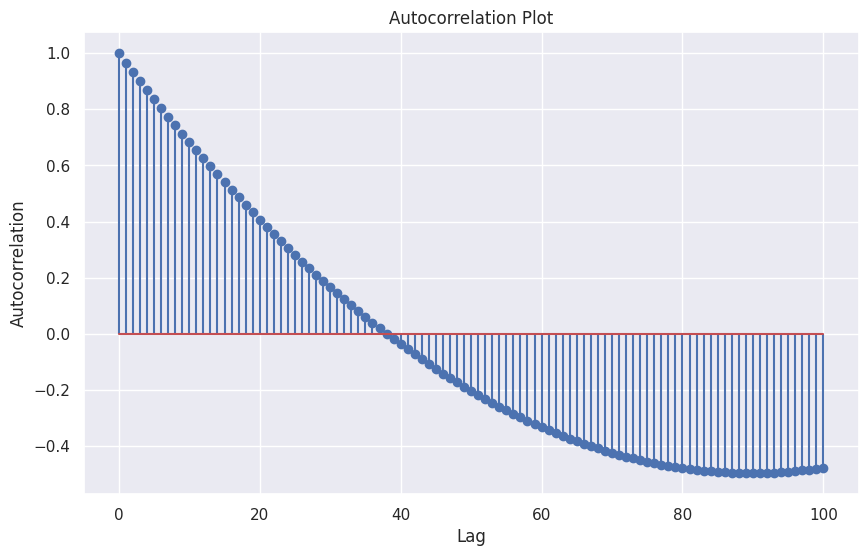

Quantile values saved to ./plots/s69/delay_quantiles.json
Saving plot to ./plots/s69/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for scheduling_delays


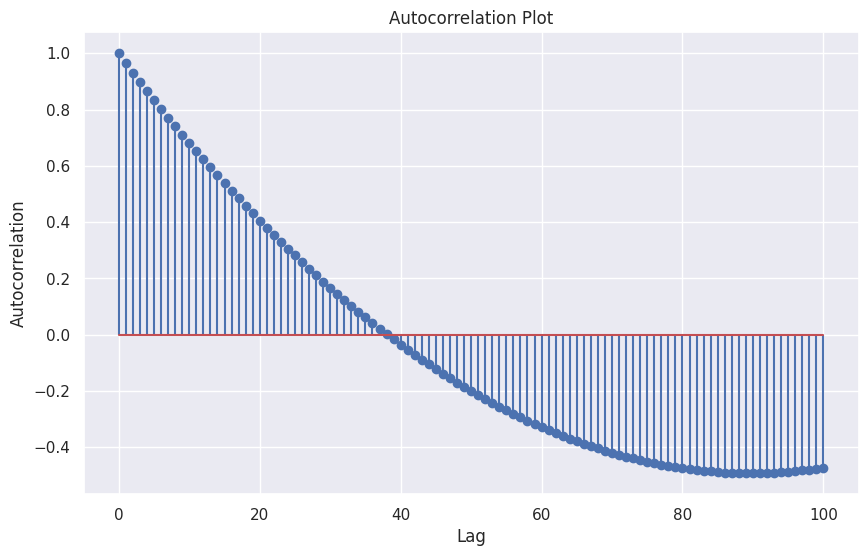

Quantile values saved to ./plots/s69/delay_quantiles.json
Saving plot to ./plots/s69/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays


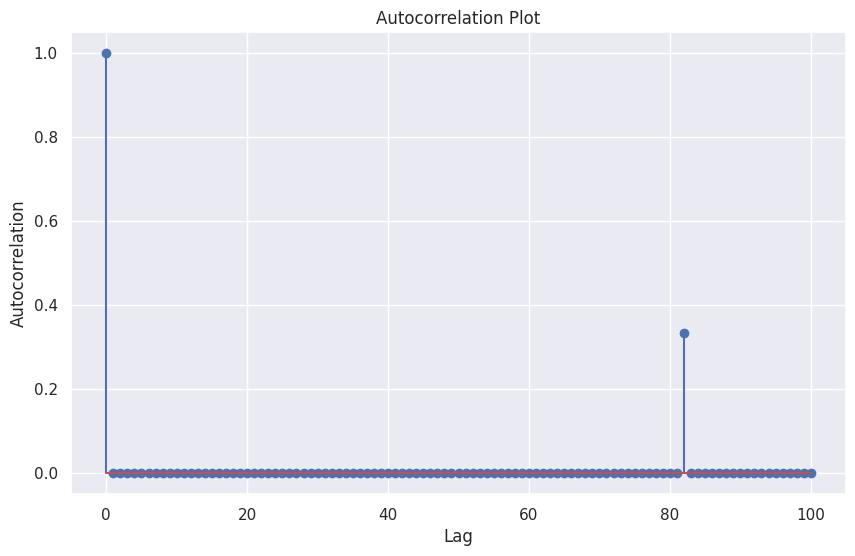

Quantile values saved to ./plots/s69/delay_quantiles.json
Saving plot to ./plots/s69/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_frame_alignment_delay


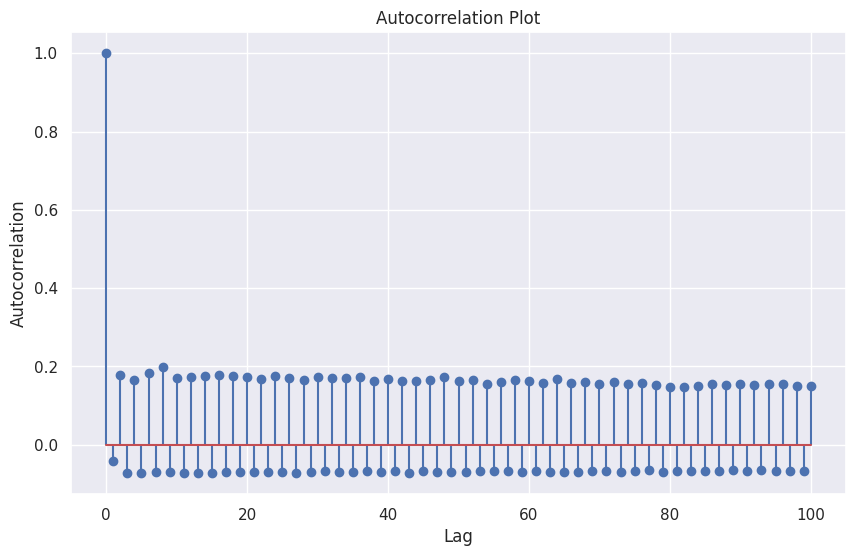

Quantile values saved to ./plots/s69/delay_quantiles.json
Saving plot to ./plots/s69/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_scheduling_delay


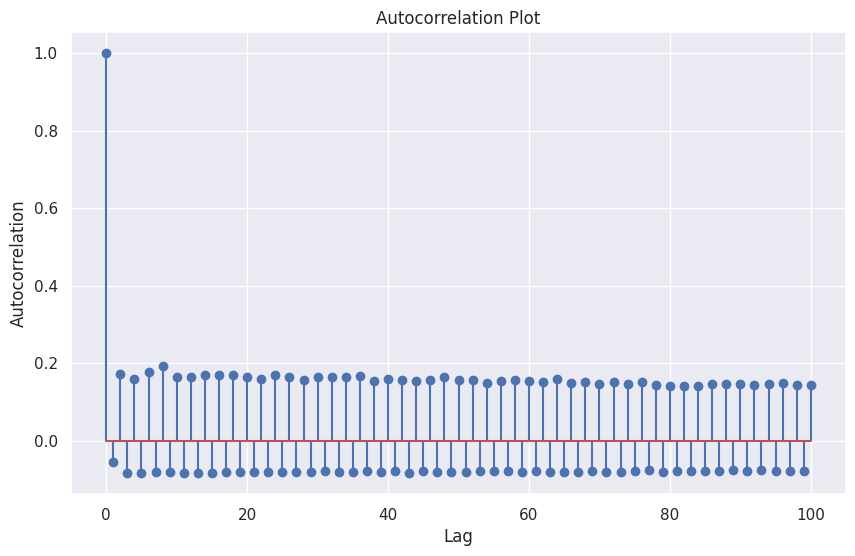

Quantile values saved to ./plots/s69/delay_quantiles.json
Saving plot to ./plots/s69/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays


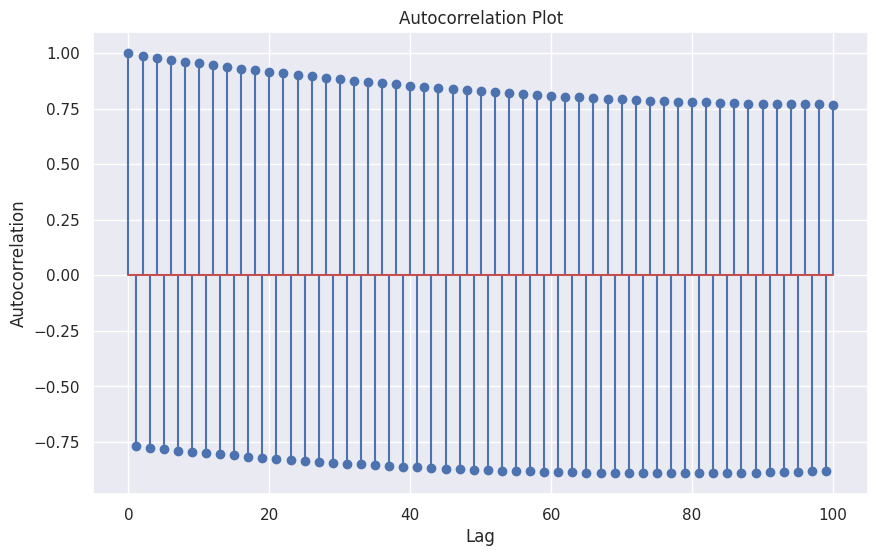

Quantile values saved to ./plots/s69/delay_quantiles.json
Saving plot to ./plots/s69/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays_wo_scheduling_delay


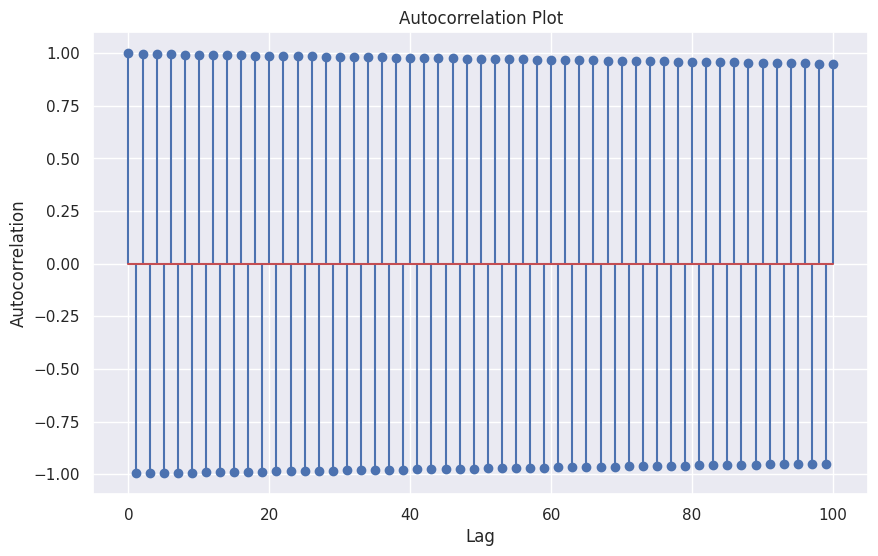

Quantile values saved to ./plots/s69/delay_quantiles.json
Saving plot to ./plots/s69/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delay


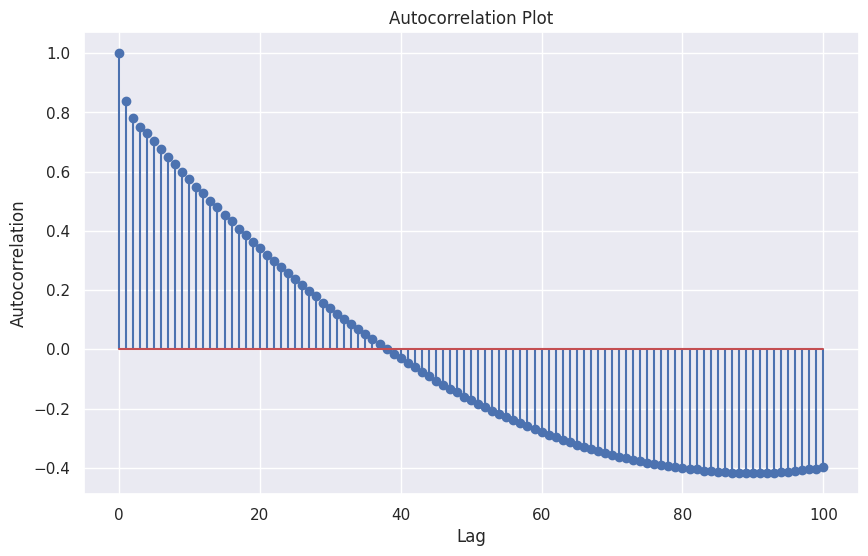

Quantile values saved to ./plots/s69/delay_quantiles.json
Saving plot to ./plots/s69/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delays_wo_scheduling_delay


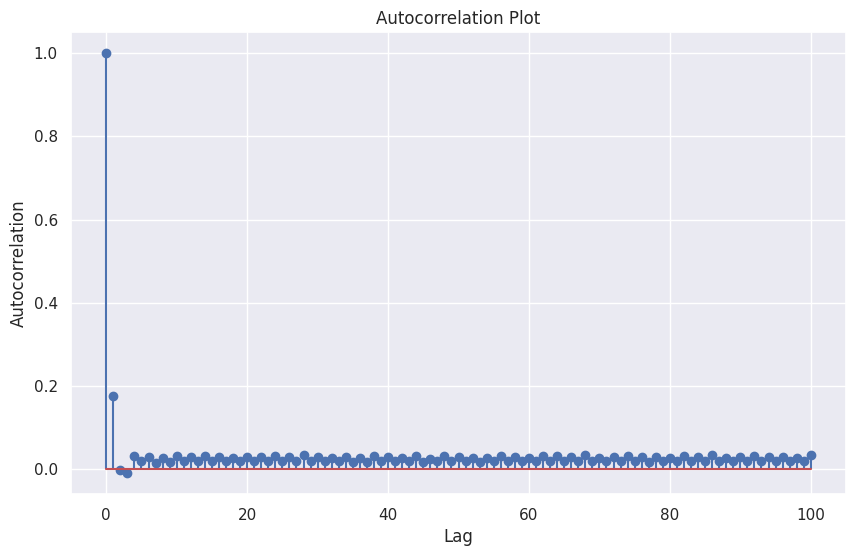

Quantile values saved to ./plots/s69/delay_quantiles.json
Saving plot to ./plots/s69/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for retx_delays


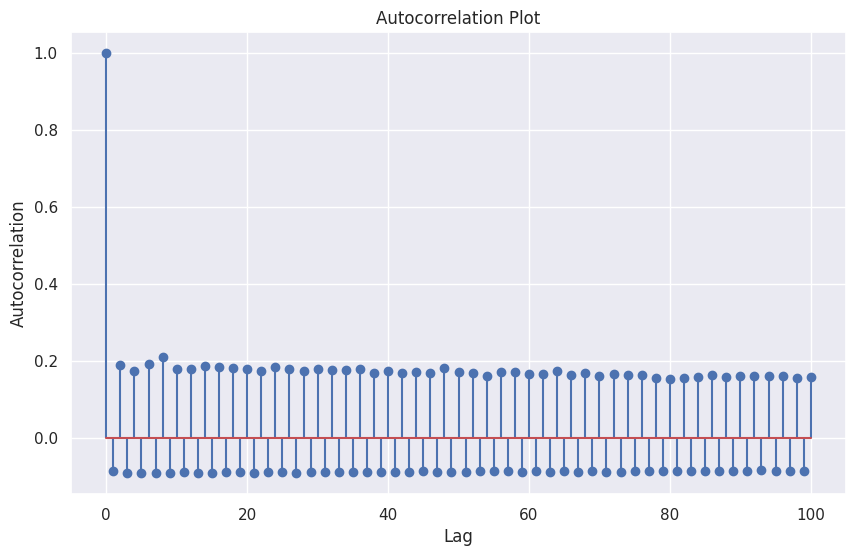

Quantile values saved to ./plots/s69/delay_quantiles.json
Saving plot to ./plots/s69/retx_delays_autocorrelation_plot.png
RNTIs in packets: ['2779']
2025-01-16 20:50:53.986 | ERROR    | decomp:get_tx_delay:166 - Packet 79888 phy.in_t or phy.in_t not present
2025-01-16 20:50:53.987 | ERROR    | decomp:get_tx_delay:166 - Packet 79888 phy.in_t or phy.in_t not present
2025-01-16 20:50:53.987 | ERROR    | decomp:get_tx_delay:166 - Packet 79887 phy.in_t or phy.in_t not present
2025-01-16 20:50:53.988 | ERROR    | decomp:get_tx_delay:166 - Packet 79887 phy.in_t or phy.in_t not present
2025-01-16 20:50:53.989 | ERROR    | decomp:get_tx_delay:166 - Packet 79870 phy.in_t or phy.in_t not present
2025-01-16 20:50:53.989 | ERROR    | decomp:get_tx_delay:166 - Packet 79870 phy.in_t or phy.in_t not present
2025-01-16 20:50:53.990 | ERROR    | decomp:get_tx_delay:166 - Packet 79869 phy.in_t or phy.in_t not present
2025-01-16 20:50:53.990 | ERROR    | decomp:get_tx_delay:166 - Packet 79869 phy.in_t or 

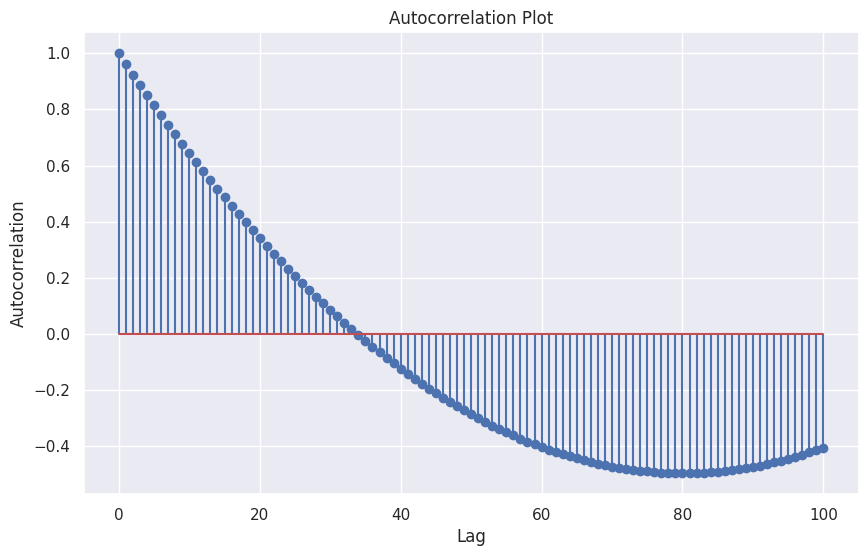

Quantile values saved to ./plots/s70/delay_quantiles.json
Saving plot to ./plots/s70/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for scheduling_delays


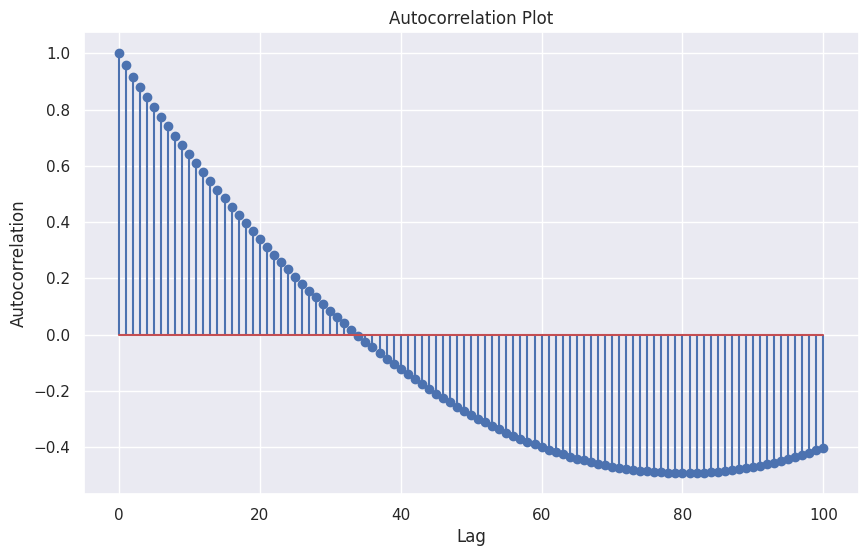

Quantile values saved to ./plots/s70/delay_quantiles.json
Saving plot to ./plots/s70/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays


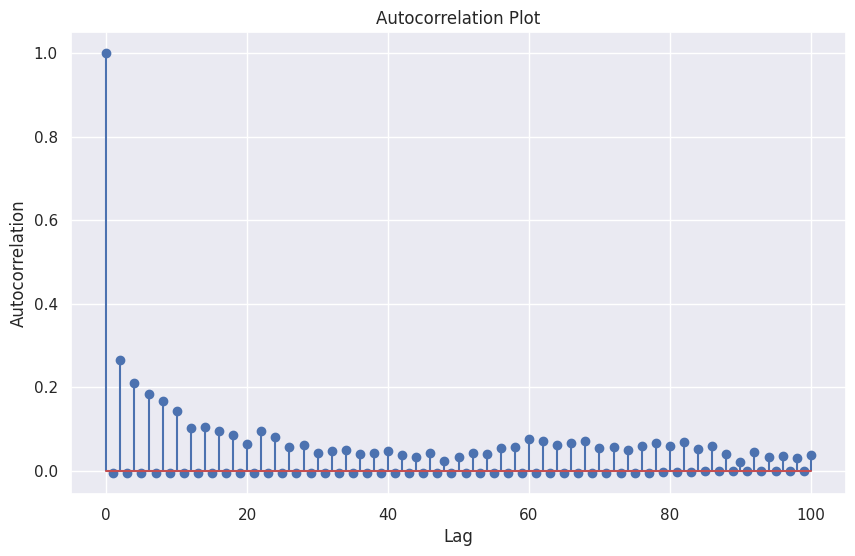

Quantile values saved to ./plots/s70/delay_quantiles.json
Saving plot to ./plots/s70/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_frame_alignment_delay


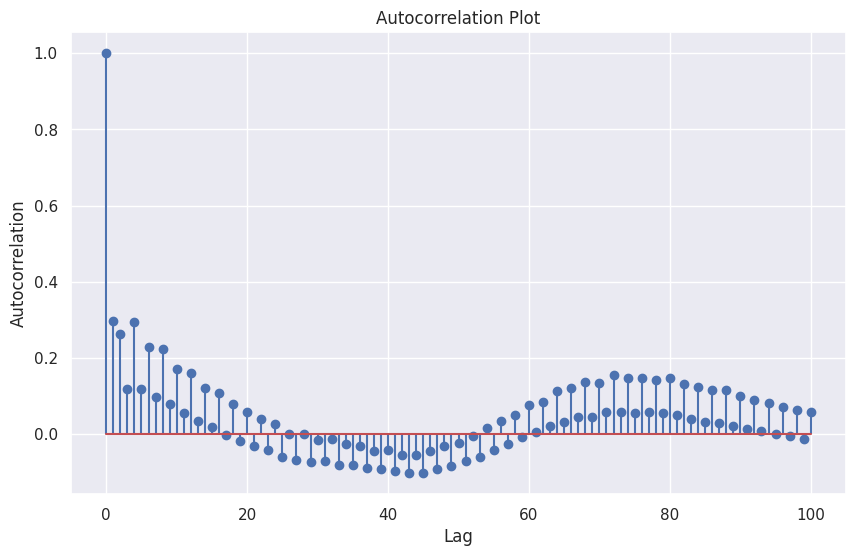

Quantile values saved to ./plots/s70/delay_quantiles.json
Saving plot to ./plots/s70/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_scheduling_delay


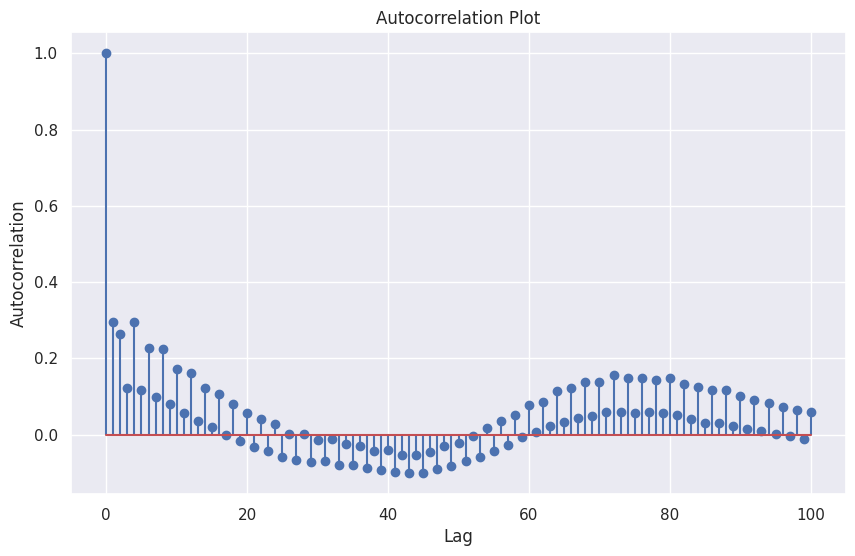

Quantile values saved to ./plots/s70/delay_quantiles.json
Saving plot to ./plots/s70/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays


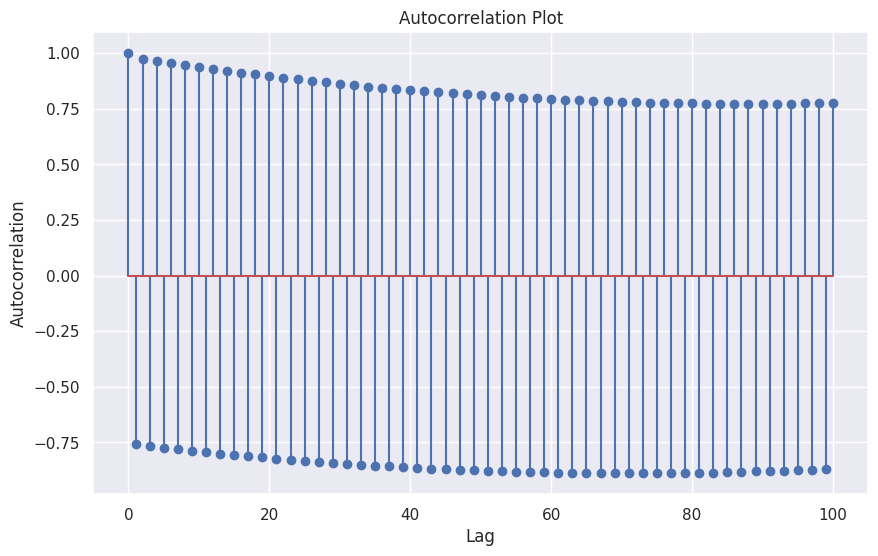

Quantile values saved to ./plots/s70/delay_quantiles.json
Saving plot to ./plots/s70/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays_wo_scheduling_delay


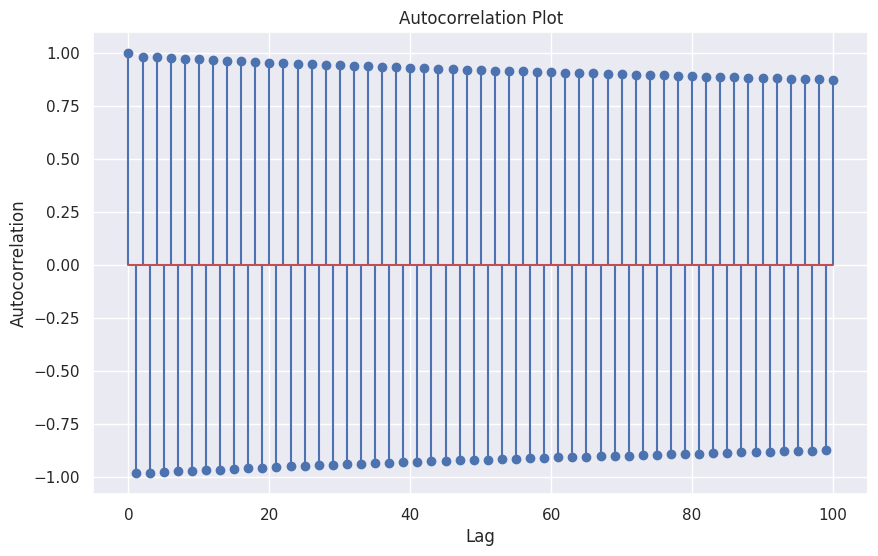

Quantile values saved to ./plots/s70/delay_quantiles.json
Saving plot to ./plots/s70/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delay


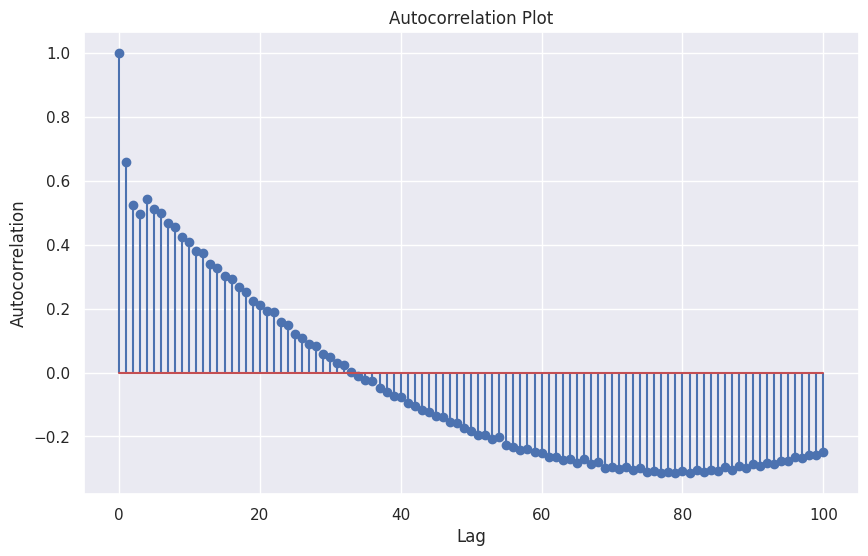

Quantile values saved to ./plots/s70/delay_quantiles.json
Saving plot to ./plots/s70/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delays_wo_scheduling_delay


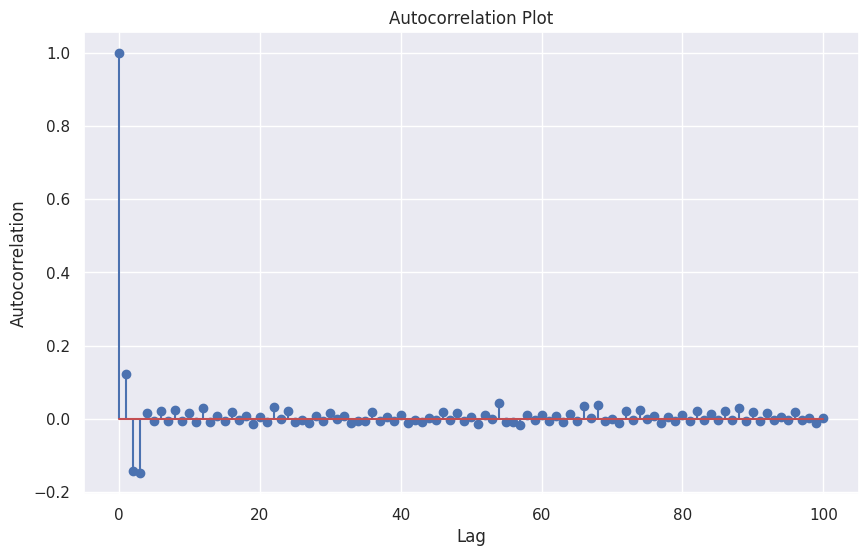

Quantile values saved to ./plots/s70/delay_quantiles.json
Saving plot to ./plots/s70/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for retx_delays


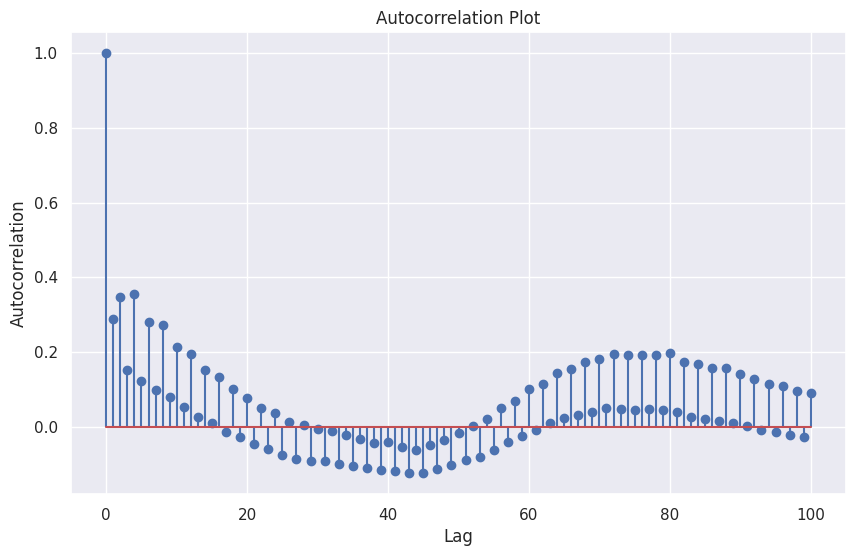

Quantile values saved to ./plots/s70/delay_quantiles.json
Saving plot to ./plots/s70/retx_delays_autocorrelation_plot.png
RNTIs in packets: ['f23c']
2025-01-16 20:51:28.506 | ERROR    | decomp:get_tx_delay:166 - Packet 39989 phy.in_t or phy.in_t not present
2025-01-16 20:51:28.507 | ERROR    | decomp:get_tx_delay:166 - Packet 39989 phy.in_t or phy.in_t not present
2025-01-16 20:51:28.508 | ERROR    | decomp:get_tx_delay:166 - Packet 39988 phy.in_t or phy.in_t not present
2025-01-16 20:51:28.508 | ERROR    | decomp:get_tx_delay:166 - Packet 39988 phy.in_t or phy.in_t not present
2025-01-16 20:51:28.518 | ERROR    | decomp:get_tx_delay:166 - Packet 39373 phy.in_t or phy.in_t not present
2025-01-16 20:51:28.519 | ERROR    | decomp:get_tx_delay:166 - Packet 39373 phy.in_t or phy.in_t not present
2025-01-16 20:51:28.519 | ERROR    | decomp:get_tx_delay:166 - Packet 39373 phy.in_t or phy.in_t not present
2025-01-16 20:51:28.520 | ERROR    | decomp:get_tx_delay:166 - Packet 39373 phy.in_t or 

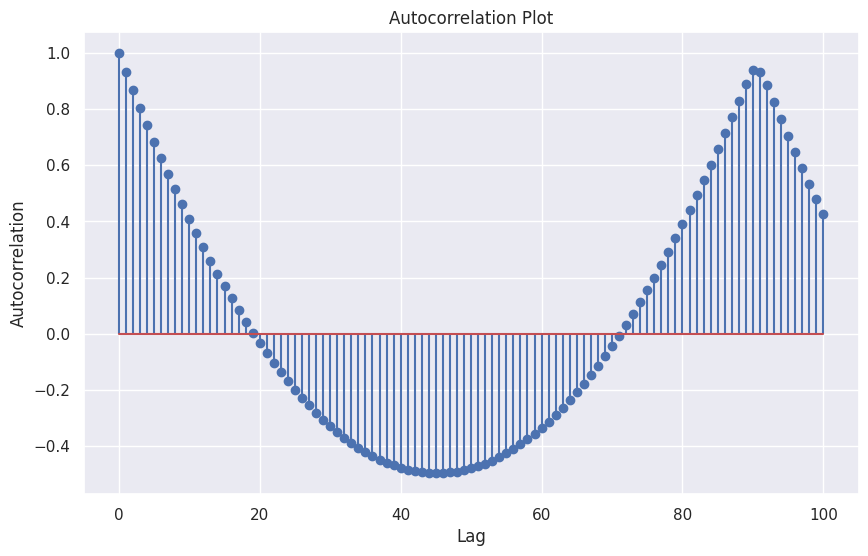

Quantile values saved to ./plots/s71/delay_quantiles.json
Saving plot to ./plots/s71/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for scheduling_delays


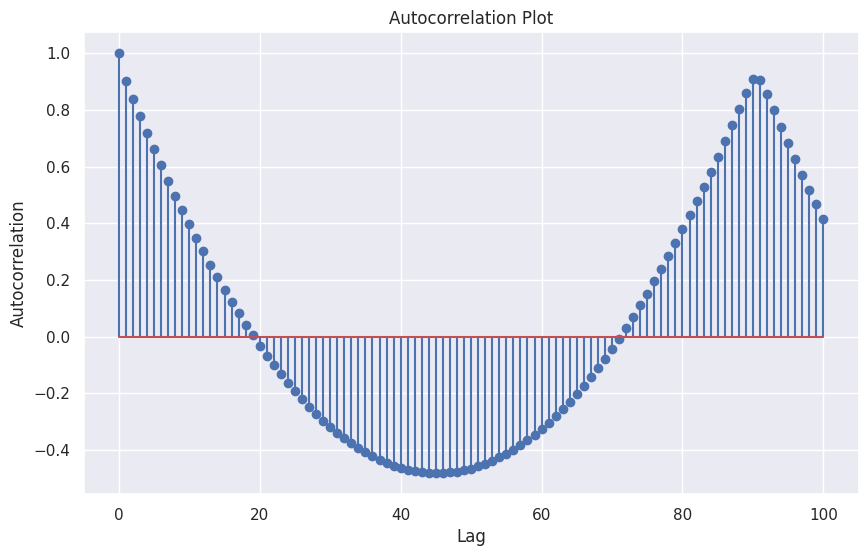

Quantile values saved to ./plots/s71/delay_quantiles.json
Saving plot to ./plots/s71/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays


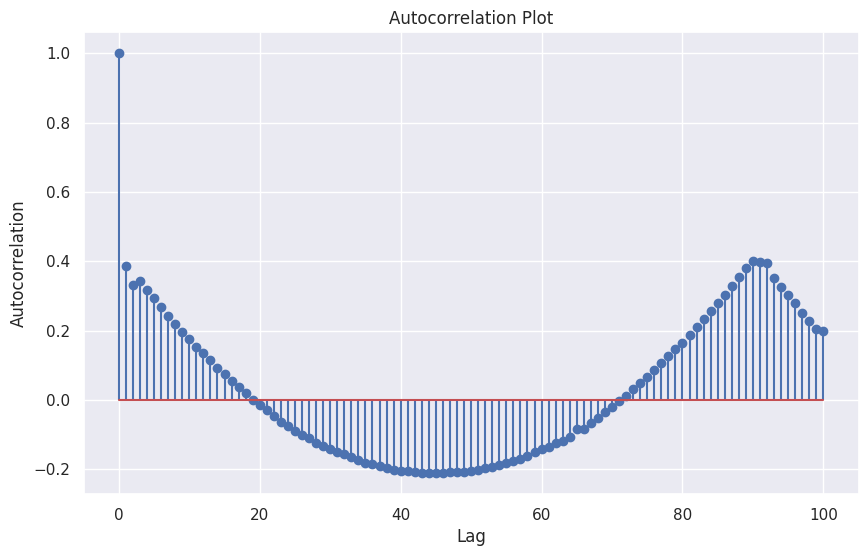

Quantile values saved to ./plots/s71/delay_quantiles.json
Saving plot to ./plots/s71/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_frame_alignment_delay


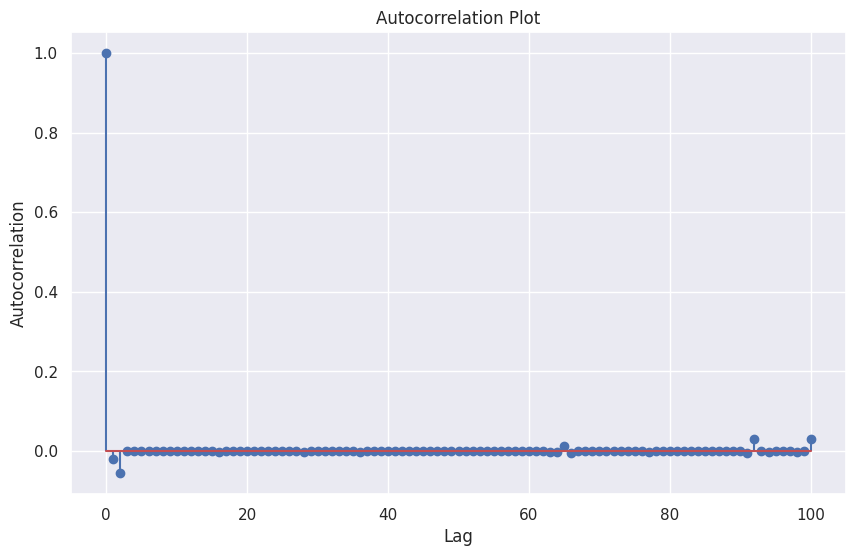

Quantile values saved to ./plots/s71/delay_quantiles.json
Saving plot to ./plots/s71/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_scheduling_delay


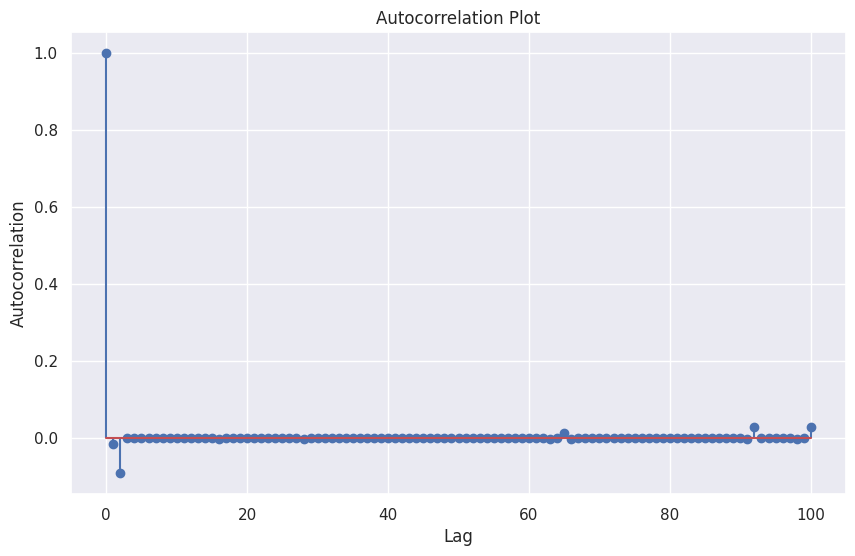

Quantile values saved to ./plots/s71/delay_quantiles.json
Saving plot to ./plots/s71/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays


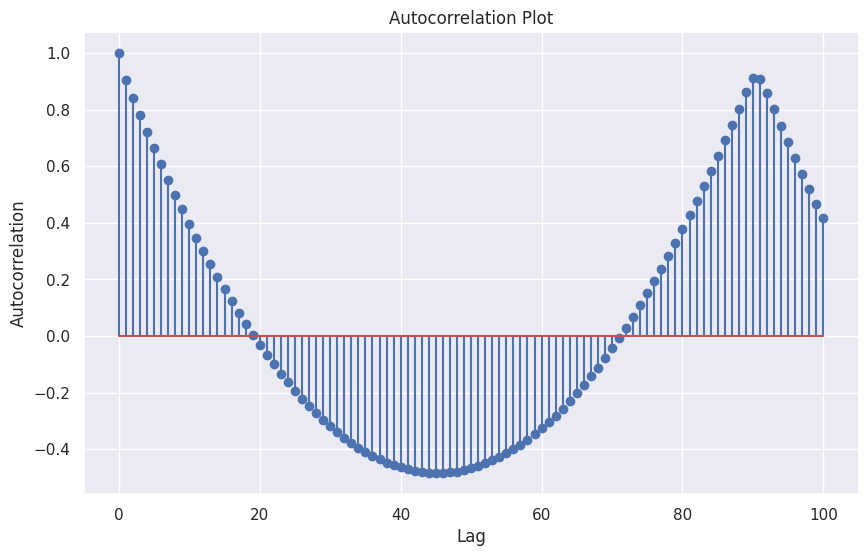

Quantile values saved to ./plots/s71/delay_quantiles.json
Saving plot to ./plots/s71/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays_wo_scheduling_delay


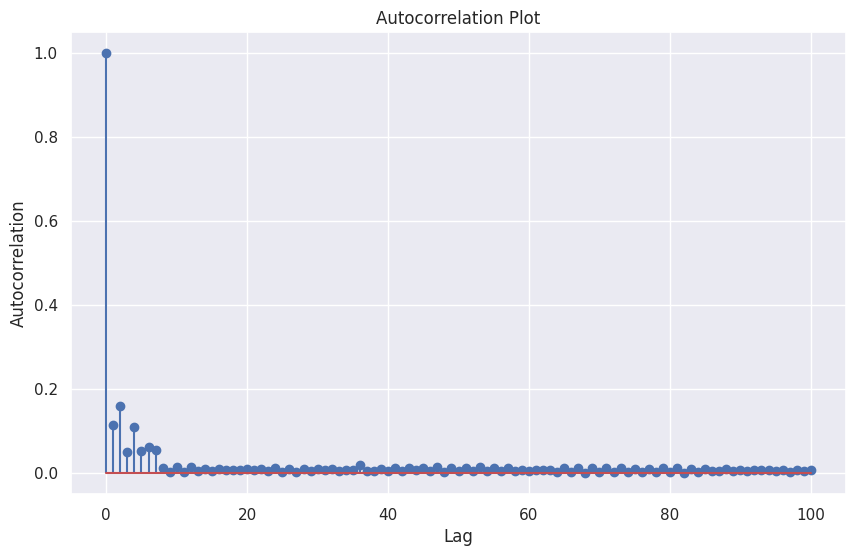

Quantile values saved to ./plots/s71/delay_quantiles.json
Saving plot to ./plots/s71/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delay


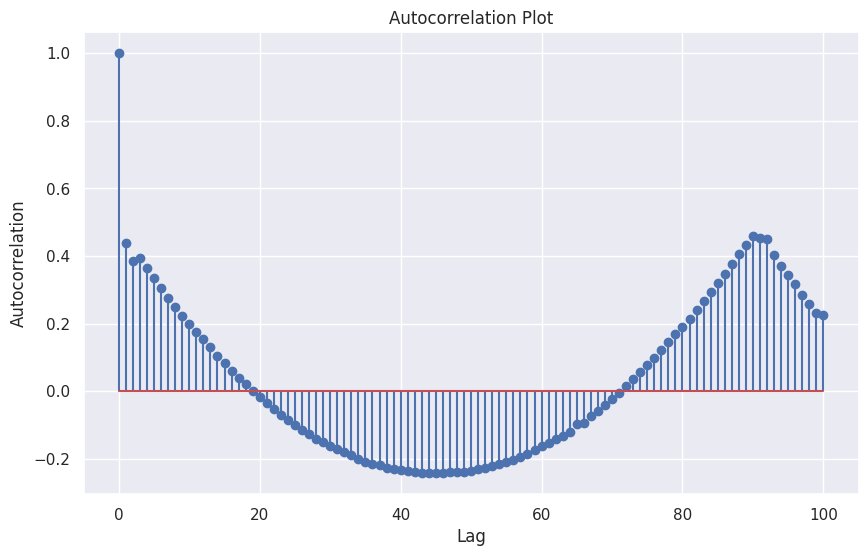

Quantile values saved to ./plots/s71/delay_quantiles.json
Saving plot to ./plots/s71/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delays_wo_scheduling_delay


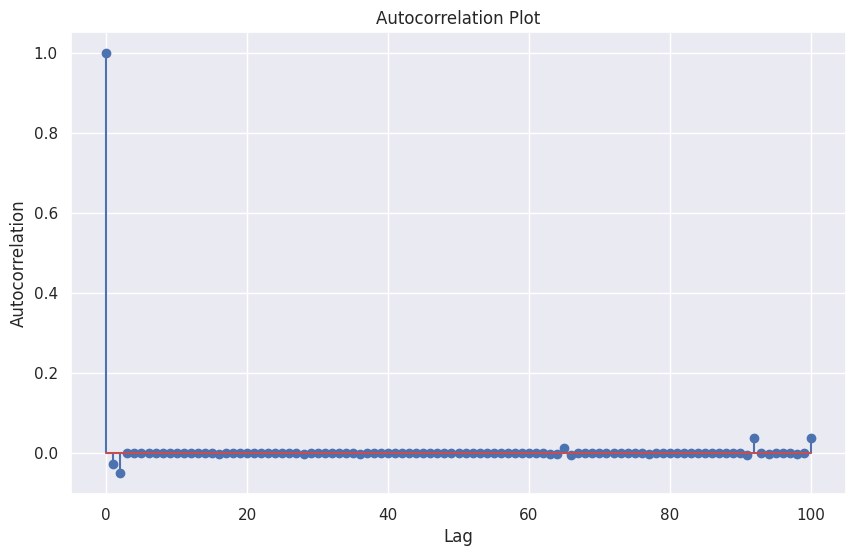

Quantile values saved to ./plots/s71/delay_quantiles.json
Saving plot to ./plots/s71/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for retx_delays


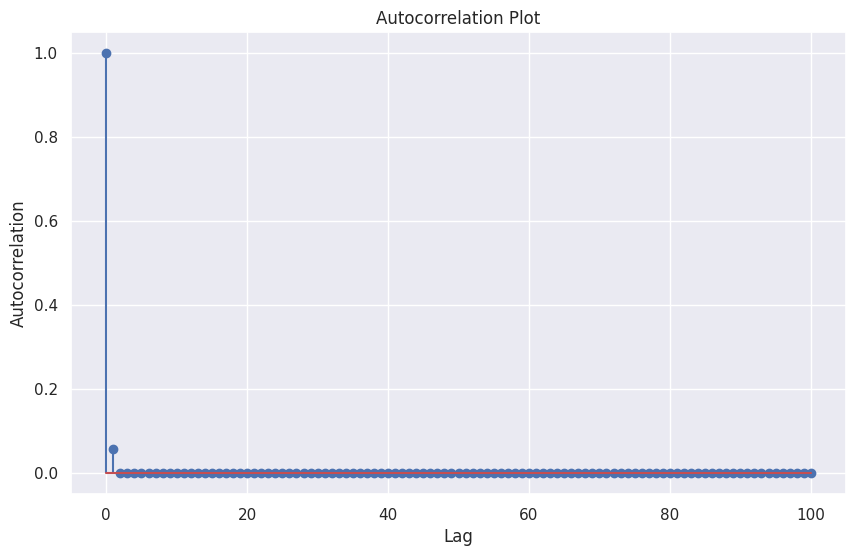

Quantile values saved to ./plots/s71/delay_quantiles.json
Saving plot to ./plots/s71/retx_delays_autocorrelation_plot.png
RNTIs in packets: ['8900']
2025-01-16 20:51:38.759 | ERROR    | decomp:get_tx_delay:166 - Packet 39872 phy.in_t or phy.in_t not present
2025-01-16 20:51:38.760 | ERROR    | decomp:get_tx_delay:166 - Packet 39872 phy.in_t or phy.in_t not present
2025-01-16 20:51:38.762 | ERROR    | decomp:get_tx_delay:166 - Packet 39871 phy.in_t or phy.in_t not present
2025-01-16 20:51:38.763 | ERROR    | decomp:get_tx_delay:166 - Packet 39871 phy.in_t or phy.in_t not present
2025-01-16 20:51:38.910 | ERROR    | decomp:get_tx_delay:166 - Packet 30690 phy.in_t or phy.in_t not present
2025-01-16 20:51:38.912 | ERROR    | decomp:get_tx_delay:166 - Packet 30690 phy.in_t or phy.in_t not present
2025-01-16 20:51:39.133 | ERROR    | decomp:get_tx_delay:166 - Packet 15826 phy.in_t or phy.in_t not present
2025-01-16 20:51:39.134 | ERROR    | decomp:get_tx_delay:166 - Packet 15826 phy.in_t or 

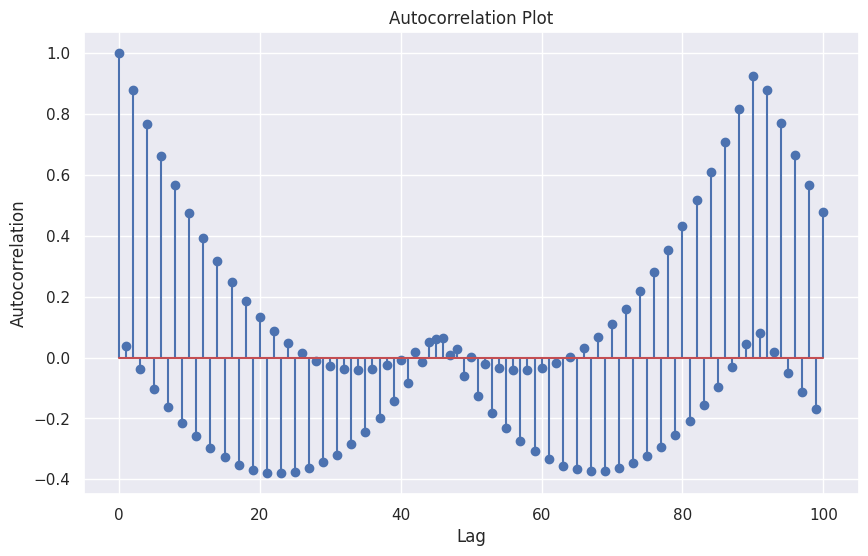

Quantile values saved to ./plots/s72/delay_quantiles.json
Saving plot to ./plots/s72/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for scheduling_delays


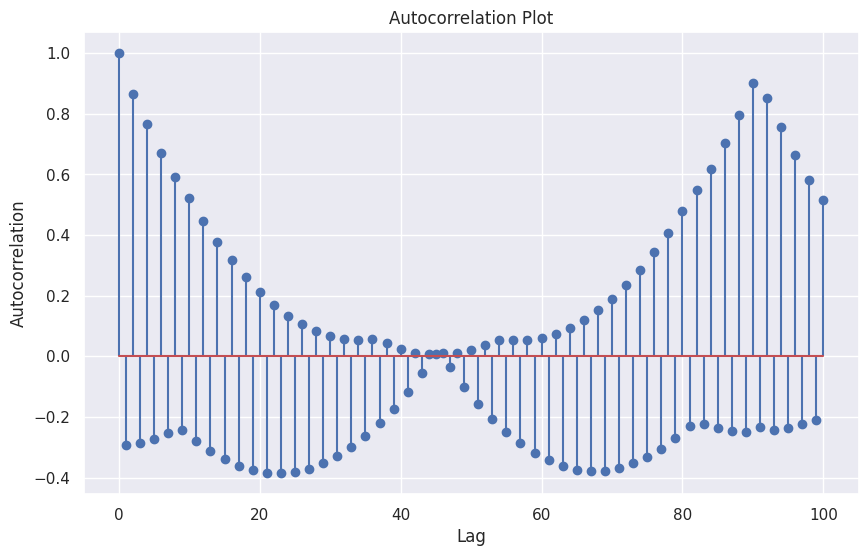

Quantile values saved to ./plots/s72/delay_quantiles.json
Saving plot to ./plots/s72/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays


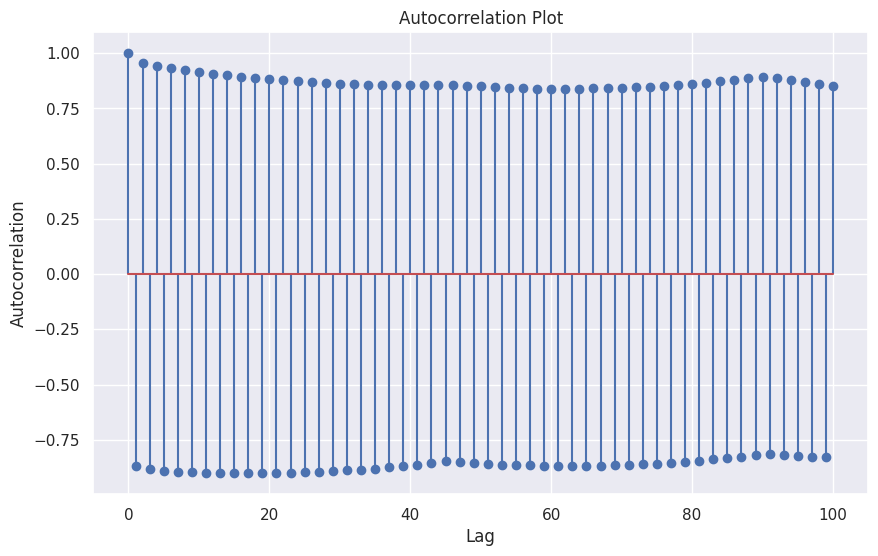

Quantile values saved to ./plots/s72/delay_quantiles.json
Saving plot to ./plots/s72/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_frame_alignment_delay


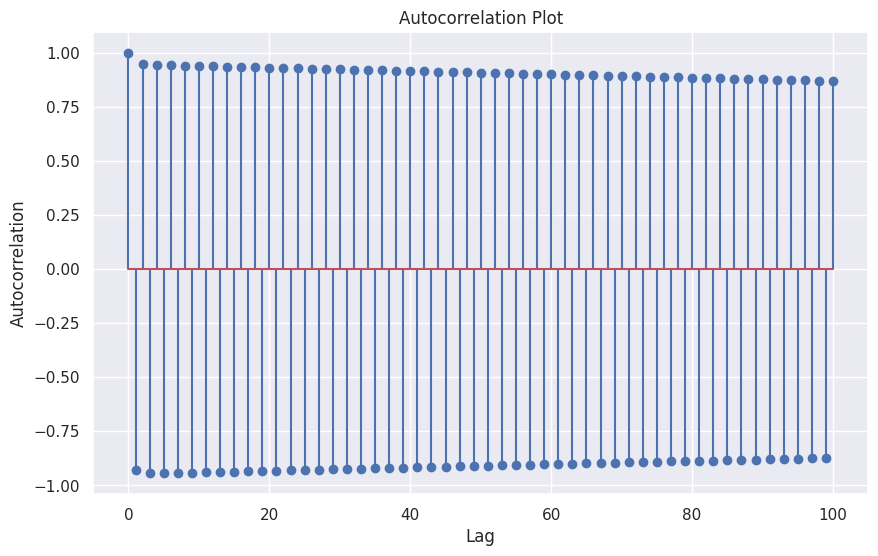

Quantile values saved to ./plots/s72/delay_quantiles.json
Saving plot to ./plots/s72/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_scheduling_delay


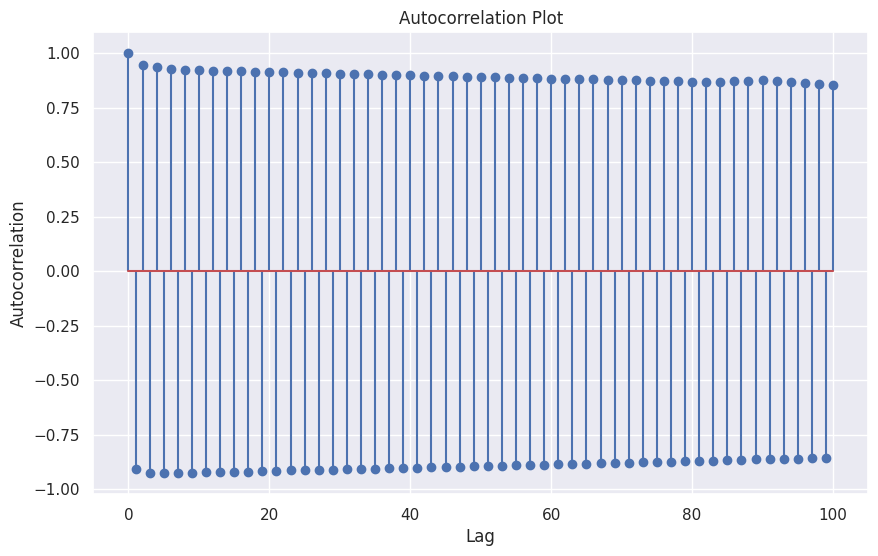

Quantile values saved to ./plots/s72/delay_quantiles.json
Saving plot to ./plots/s72/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays


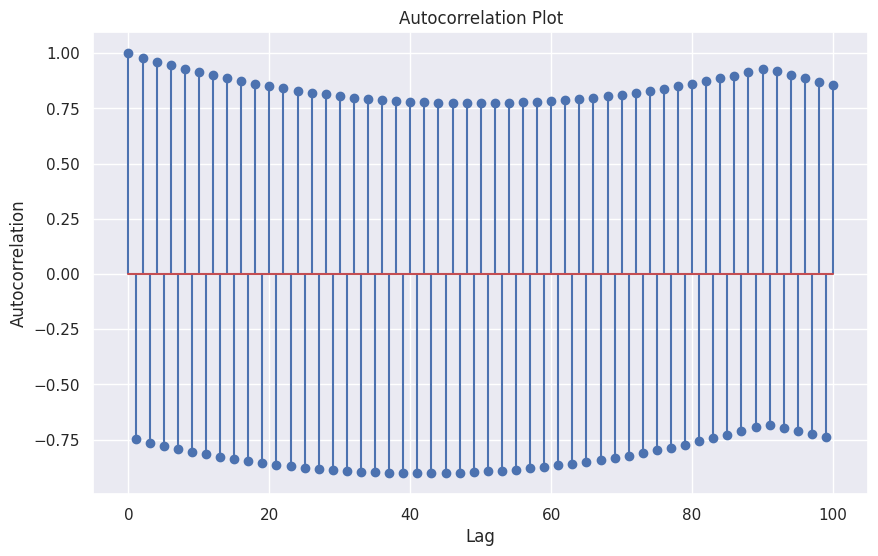

Quantile values saved to ./plots/s72/delay_quantiles.json
Saving plot to ./plots/s72/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays_wo_scheduling_delay


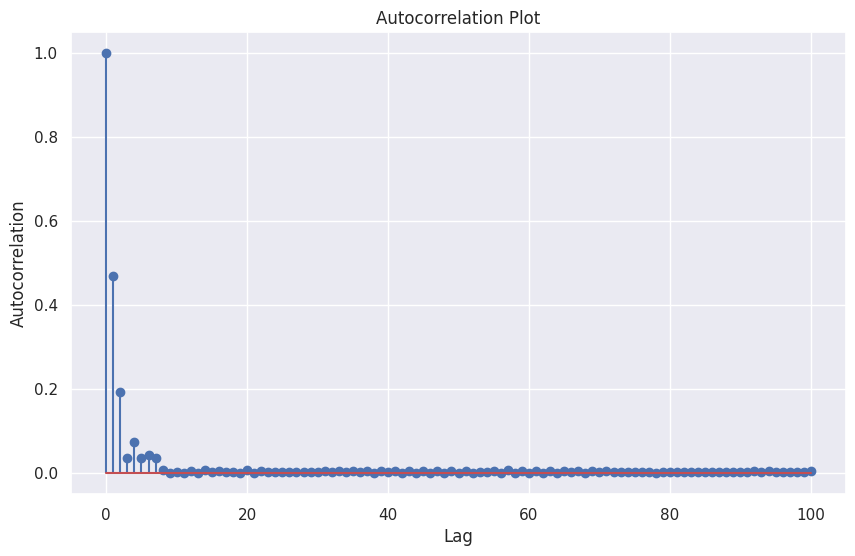

Quantile values saved to ./plots/s72/delay_quantiles.json
Saving plot to ./plots/s72/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delay


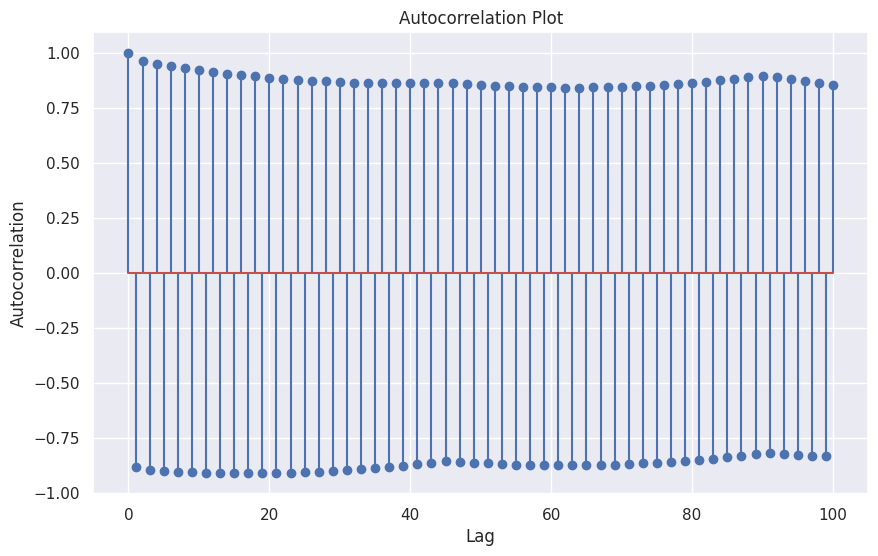

Quantile values saved to ./plots/s72/delay_quantiles.json
Saving plot to ./plots/s72/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delays_wo_scheduling_delay


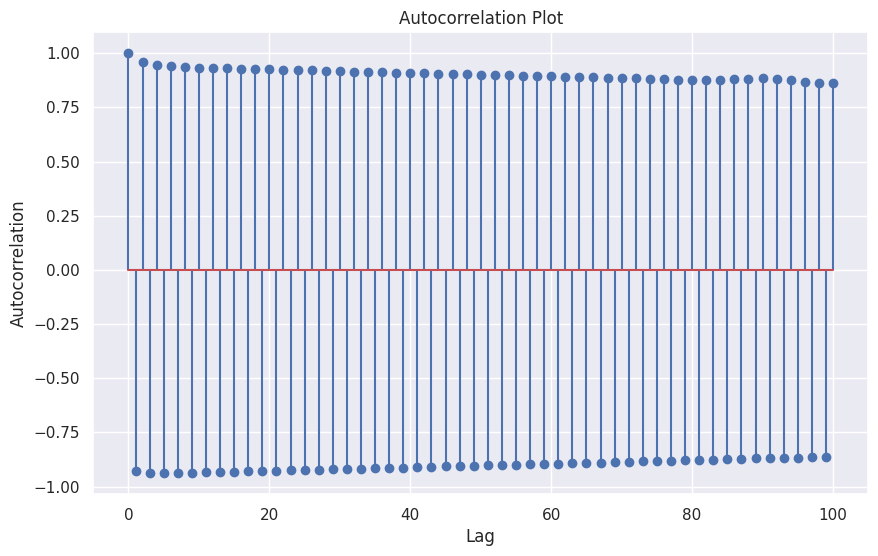

Quantile values saved to ./plots/s72/delay_quantiles.json
Saving plot to ./plots/s72/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for retx_delays


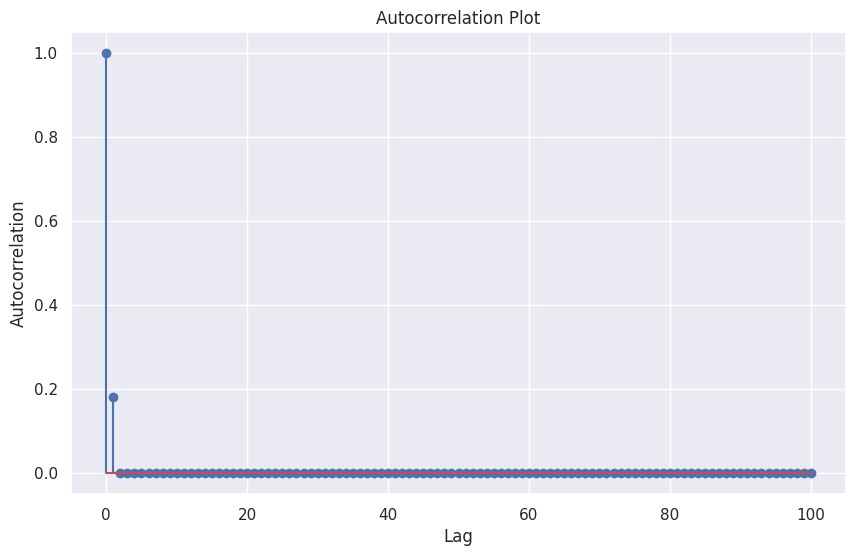

Quantile values saved to ./plots/s72/delay_quantiles.json
Saving plot to ./plots/s72/retx_delays_autocorrelation_plot.png
RNTIs in packets: ['8867']
2025-01-16 20:51:43.427 | ERROR    | decomp:get_tx_delay:166 - Packet 1977 phy.in_t or phy.in_t not present
2025-01-16 20:51:43.428 | ERROR    | decomp:get_tx_delay:166 - Packet 1977 phy.in_t or phy.in_t not present
2025-01-16 20:51:43.430 | ERROR    | decomp:get_tx_delay:166 - Packet 1928 phy.in_t or phy.in_t not present
2025-01-16 20:51:43.431 | ERROR    | decomp:get_tx_delay:166 - Packet 1928 phy.in_t or phy.in_t not present
2025-01-16 20:51:43.431 | ERROR    | decomp:get_tx_delay:166 - Packet 1916 phy.in_t or phy.in_t not present
2025-01-16 20:51:43.432 | ERROR    | decomp:get_tx_delay:166 - Packet 1916 phy.in_t or phy.in_t not present
2025-01-16 20:51:43.433 | ERROR    | decomp:get_tx_delay:166 - Packet 1908 phy.in_t or phy.in_t not present
2025-01-16 20:51:43.433 | ERROR    | decomp:get_tx_delay:166 - Packet 1908 phy.in_t or phy.in_t

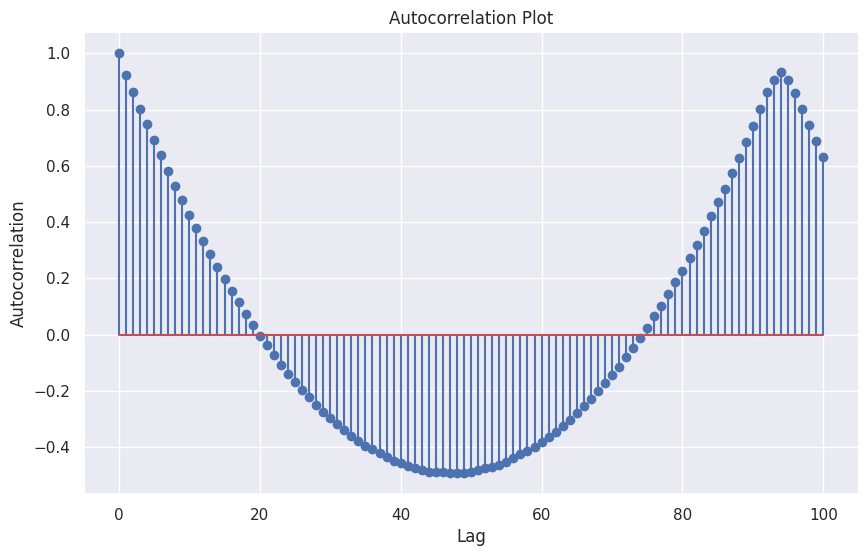

Quantile values saved to ./plots/s73/delay_quantiles.json
Saving plot to ./plots/s73/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for scheduling_delays


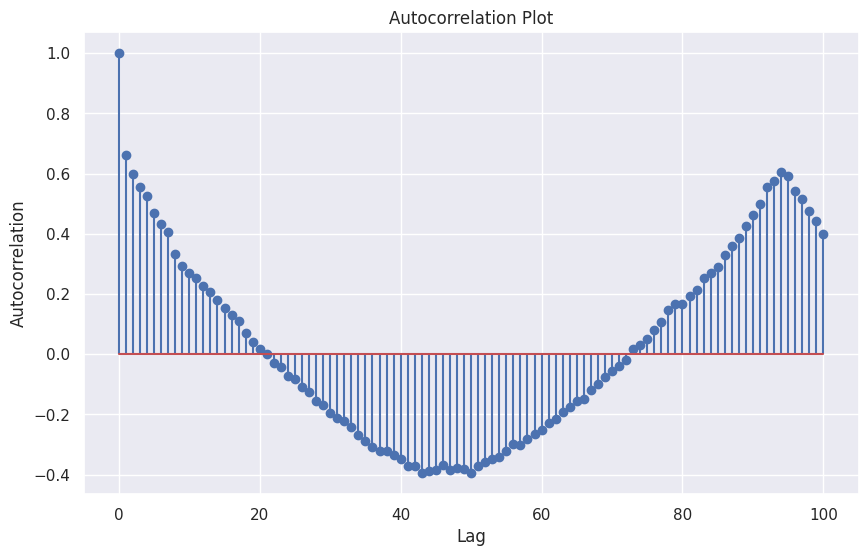

Quantile values saved to ./plots/s73/delay_quantiles.json
Saving plot to ./plots/s73/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays


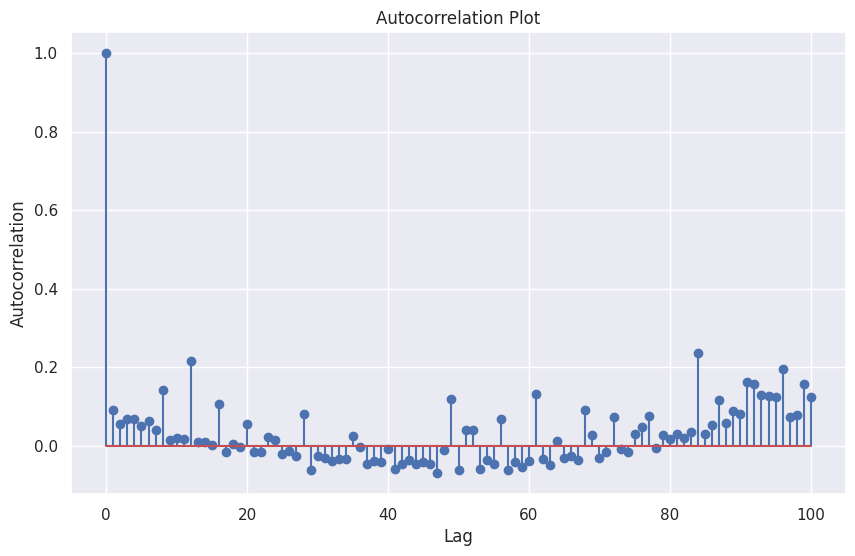

Quantile values saved to ./plots/s73/delay_quantiles.json
Saving plot to ./plots/s73/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_frame_alignment_delay


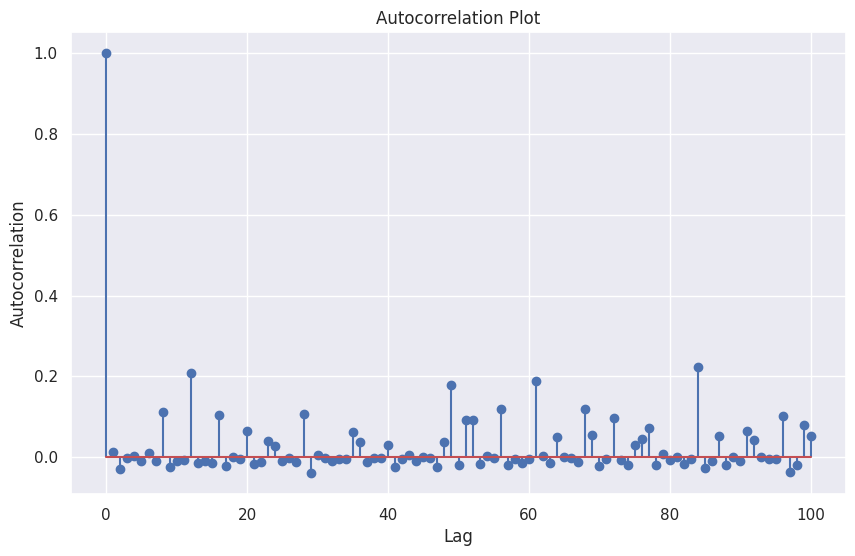

Quantile values saved to ./plots/s73/delay_quantiles.json
Saving plot to ./plots/s73/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_scheduling_delay


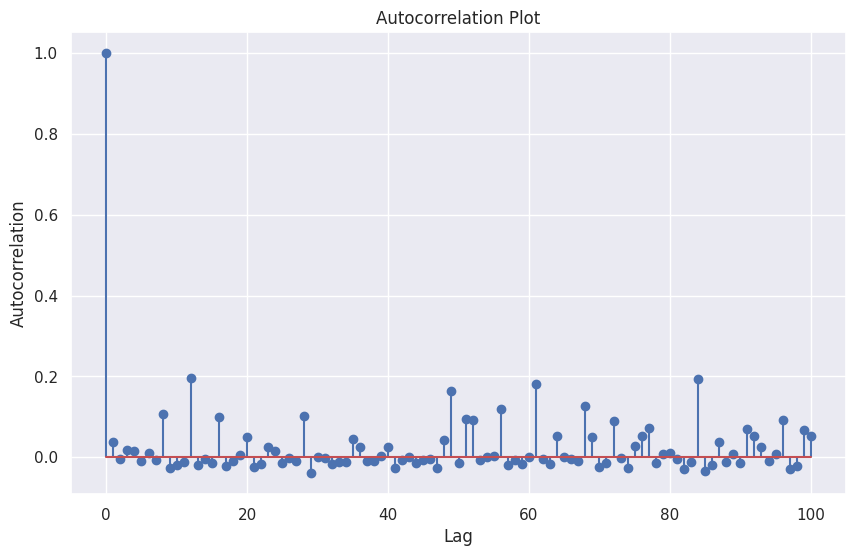

Quantile values saved to ./plots/s73/delay_quantiles.json
Saving plot to ./plots/s73/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays


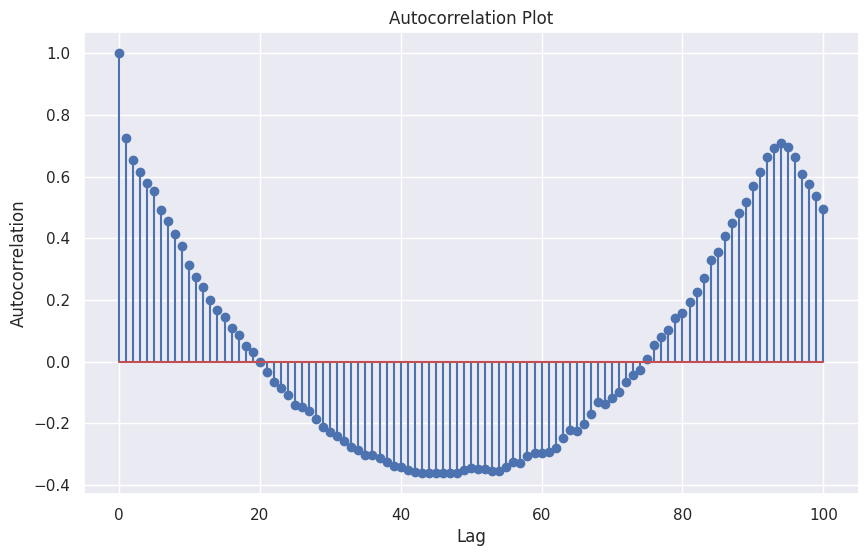

Quantile values saved to ./plots/s73/delay_quantiles.json
Saving plot to ./plots/s73/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays_wo_scheduling_delay


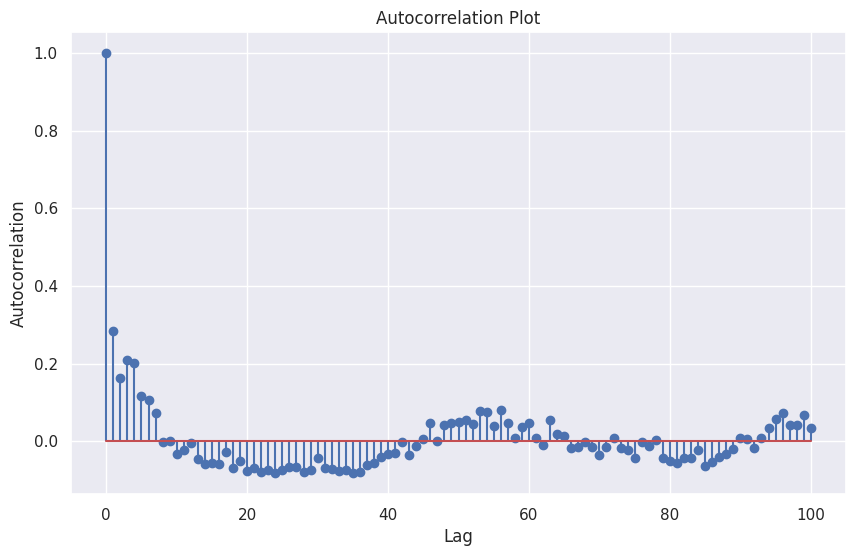

Quantile values saved to ./plots/s73/delay_quantiles.json
Saving plot to ./plots/s73/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delay


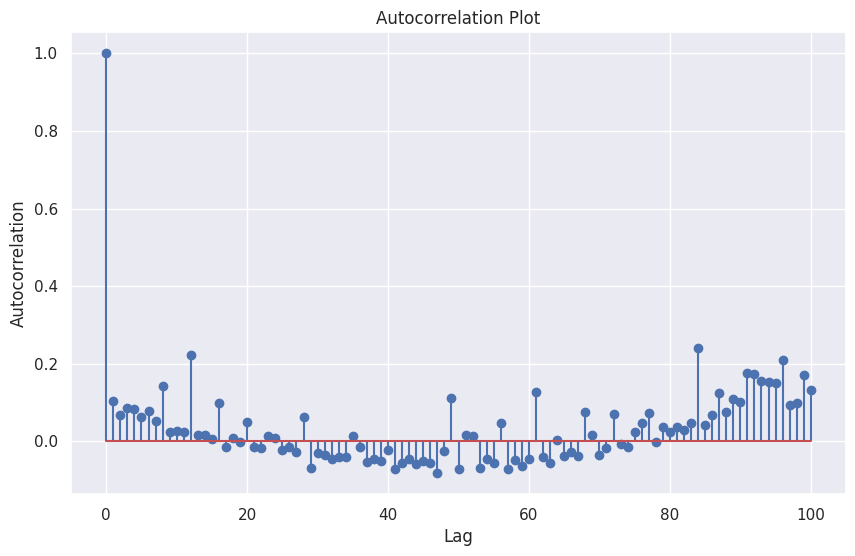

Quantile values saved to ./plots/s73/delay_quantiles.json
Saving plot to ./plots/s73/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delays_wo_scheduling_delay


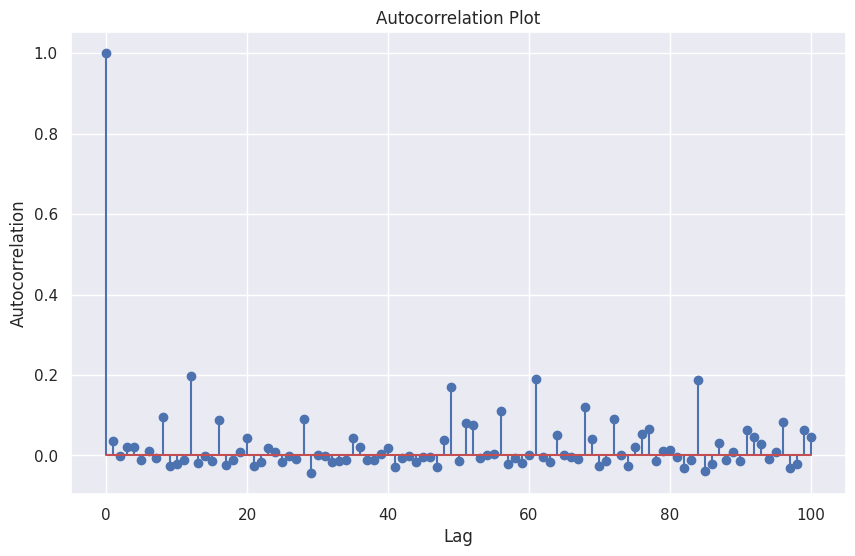

Quantile values saved to ./plots/s73/delay_quantiles.json
Saving plot to ./plots/s73/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for retx_delays


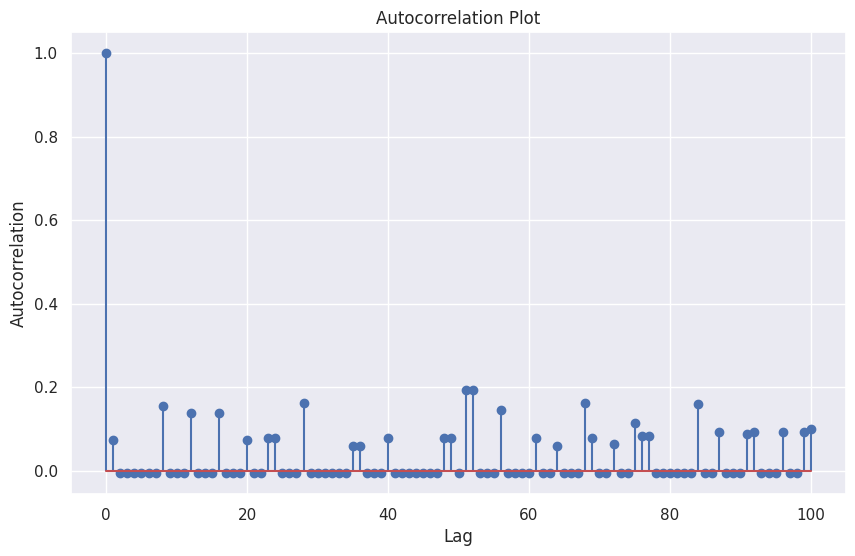

Quantile values saved to ./plots/s73/delay_quantiles.json
Saving plot to ./plots/s73/retx_delays_autocorrelation_plot.png
RNTIs in packets: ['163e']
2025-01-16 20:51:46.532 | ERROR    | decomp:get_tx_delay:166 - Packet 1643 phy.in_t or phy.in_t not present
2025-01-16 20:51:46.533 | ERROR    | decomp:get_tx_delay:166 - Packet 1643 phy.in_t or phy.in_t not present
2025-01-16 20:51:46.534 | ERROR    | decomp:get_tx_delay:166 - Packet 1593 phy.in_t or phy.in_t not present
2025-01-16 20:51:46.534 | ERROR    | decomp:get_tx_delay:166 - Packet 1593 phy.in_t or phy.in_t not present
2025-01-16 20:51:46.538 | ERROR    | decomp:get_tx_delay:166 - Packet 1440 phy.in_t or phy.in_t not present
2025-01-16 20:51:46.541 | ERROR    | decomp:get_tx_delay:166 - Packet 1440 phy.in_t or phy.in_t not present
2025-01-16 20:51:46.544 | ERROR    | decomp:get_tx_delay:166 - Packet 1232 phy.in_t or phy.in_t not present
2025-01-16 20:51:46.546 | ERROR    | decomp:get_tx_delay:166 - Packet 1232 phy.in_t or phy.in_t

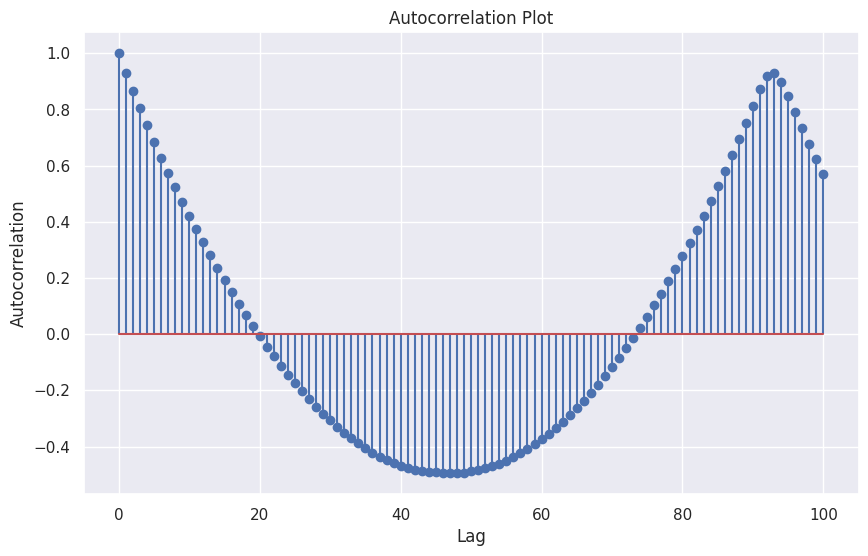

Quantile values saved to ./plots/s74/delay_quantiles.json
Saving plot to ./plots/s74/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for scheduling_delays


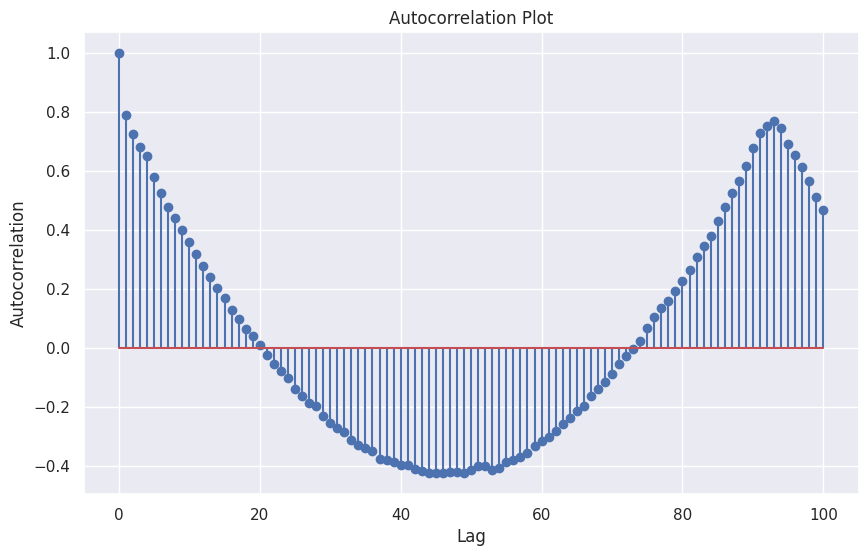

Quantile values saved to ./plots/s74/delay_quantiles.json
Saving plot to ./plots/s74/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays


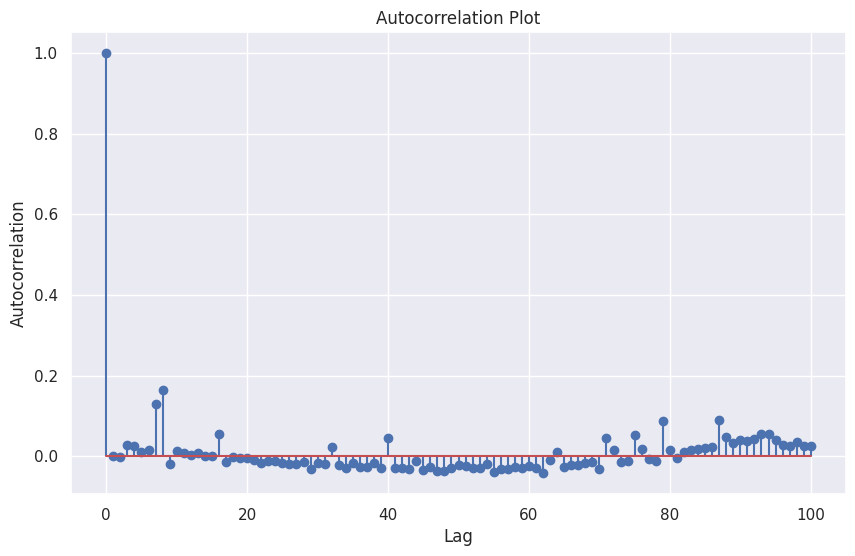

Quantile values saved to ./plots/s74/delay_quantiles.json
Saving plot to ./plots/s74/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_frame_alignment_delay


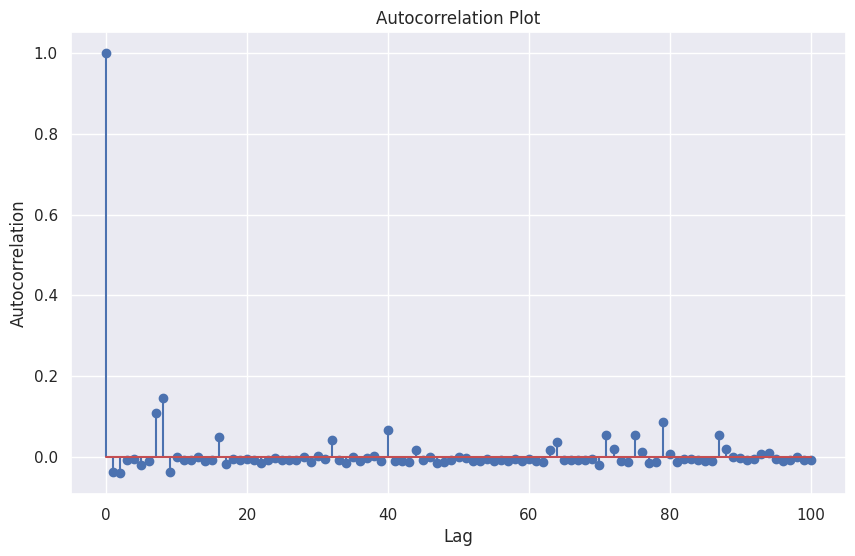

Quantile values saved to ./plots/s74/delay_quantiles.json
Saving plot to ./plots/s74/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_scheduling_delay


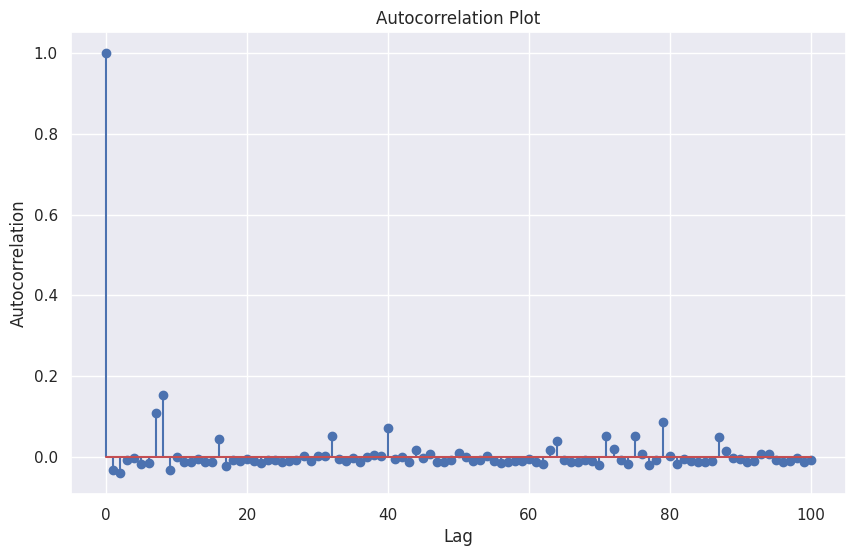

Quantile values saved to ./plots/s74/delay_quantiles.json
Saving plot to ./plots/s74/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays


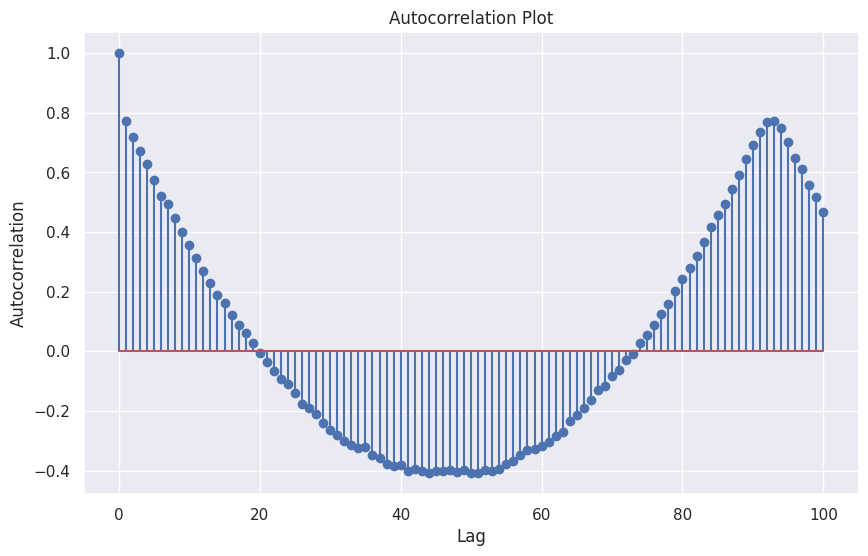

Quantile values saved to ./plots/s74/delay_quantiles.json
Saving plot to ./plots/s74/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays_wo_scheduling_delay


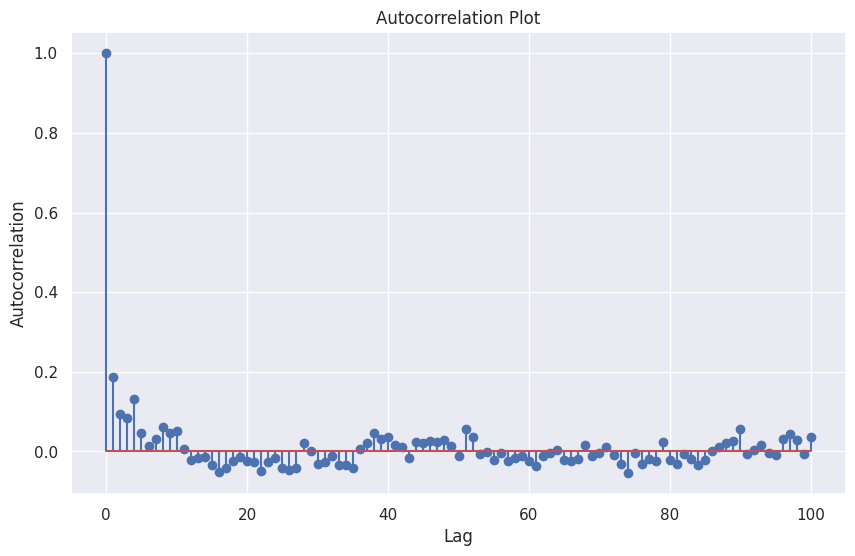

Quantile values saved to ./plots/s74/delay_quantiles.json
Saving plot to ./plots/s74/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delay


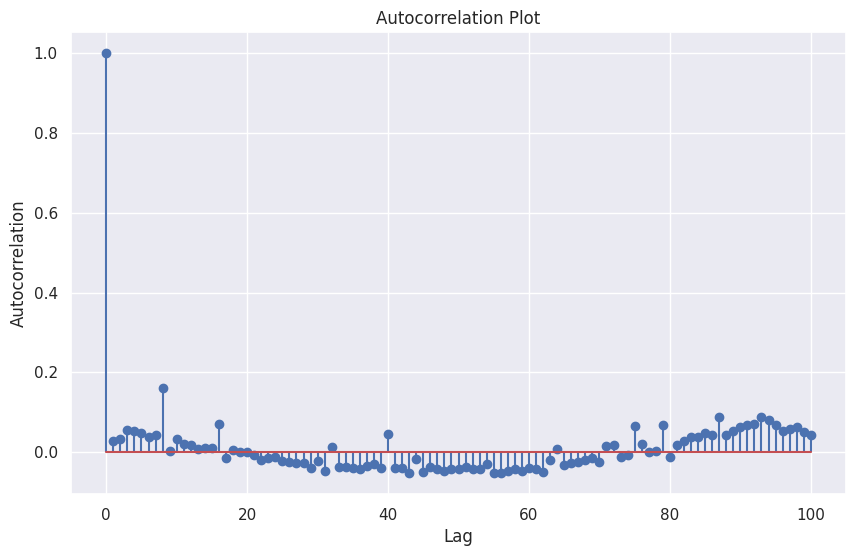

Quantile values saved to ./plots/s74/delay_quantiles.json
Saving plot to ./plots/s74/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delays_wo_scheduling_delay


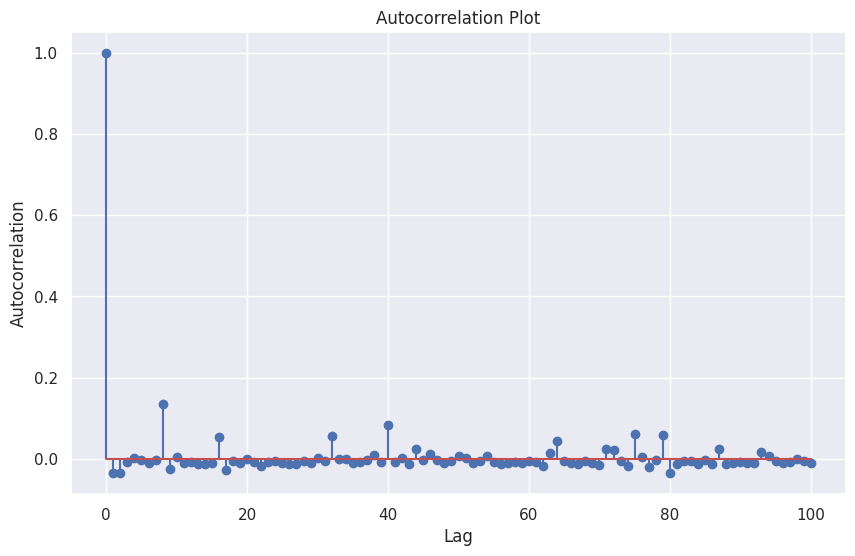

Quantile values saved to ./plots/s74/delay_quantiles.json
Saving plot to ./plots/s74/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for retx_delays


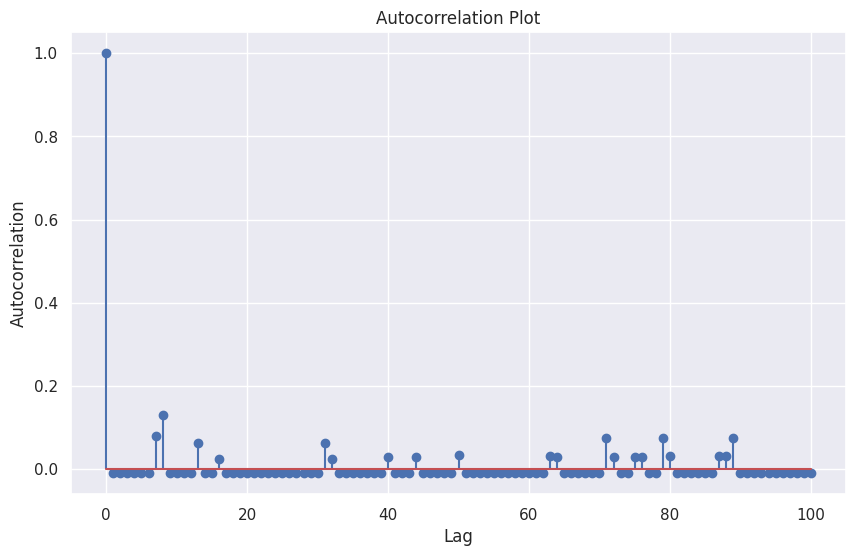

Quantile values saved to ./plots/s74/delay_quantiles.json
Saving plot to ./plots/s74/retx_delays_autocorrelation_plot.png
RNTIs in packets: ['20d2']
2025-01-16 20:51:48.579 | ERROR    | decomp:get_tx_delay:166 - Packet 3555 phy.in_t or phy.in_t not present
2025-01-16 20:51:48.580 | ERROR    | decomp:get_tx_delay:166 - Packet 3555 phy.in_t or phy.in_t not present
2025-01-16 20:51:48.616 | ERROR    | decomp:get_tx_delay:166 - Packet 3555 phy.in_t or phy.in_t not present
2025-01-16 20:51:48.616 | ERROR    | decomp:get_tx_delay:166 - Packet 3555 phy.in_t or phy.in_t not present
Plotting autocorrelation for frame_alignment_delays


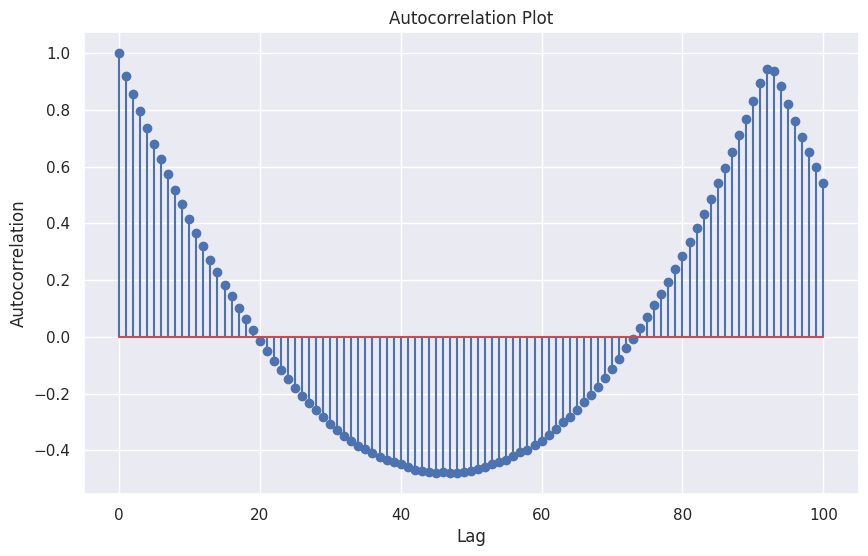

Quantile values saved to ./plots/s75/delay_quantiles.json
Saving plot to ./plots/s75/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for scheduling_delays


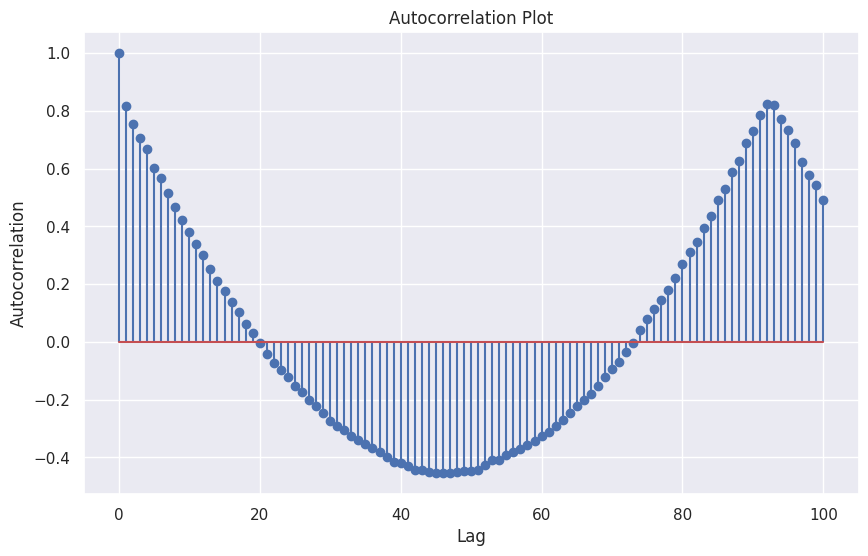

Quantile values saved to ./plots/s75/delay_quantiles.json
Saving plot to ./plots/s75/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays


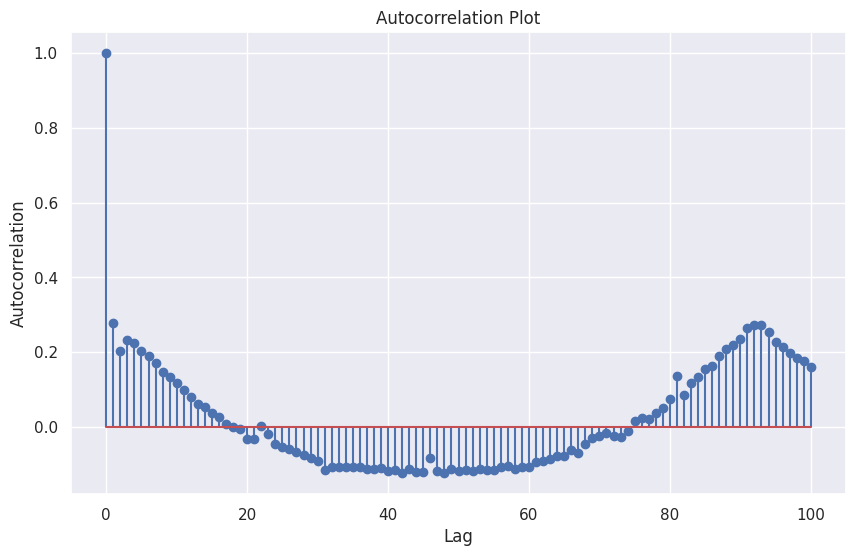

Quantile values saved to ./plots/s75/delay_quantiles.json
Saving plot to ./plots/s75/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_frame_alignment_delay


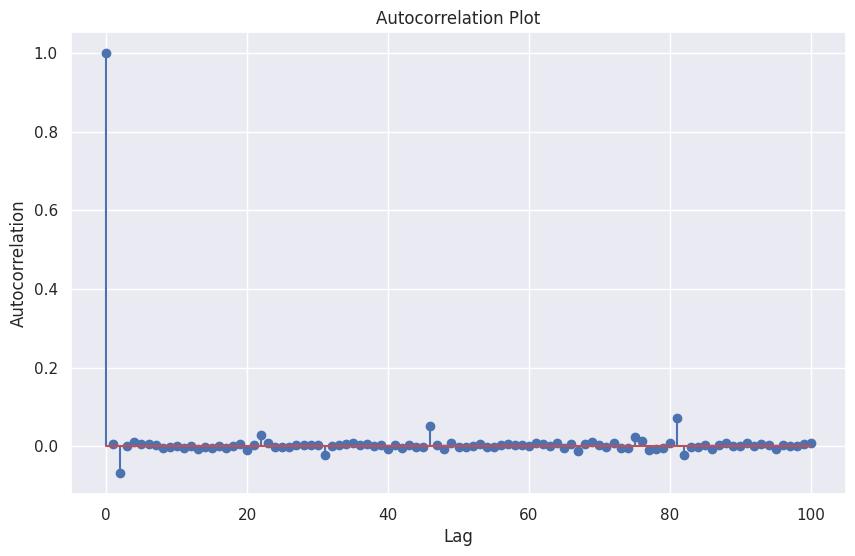

Quantile values saved to ./plots/s75/delay_quantiles.json
Saving plot to ./plots/s75/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_scheduling_delay


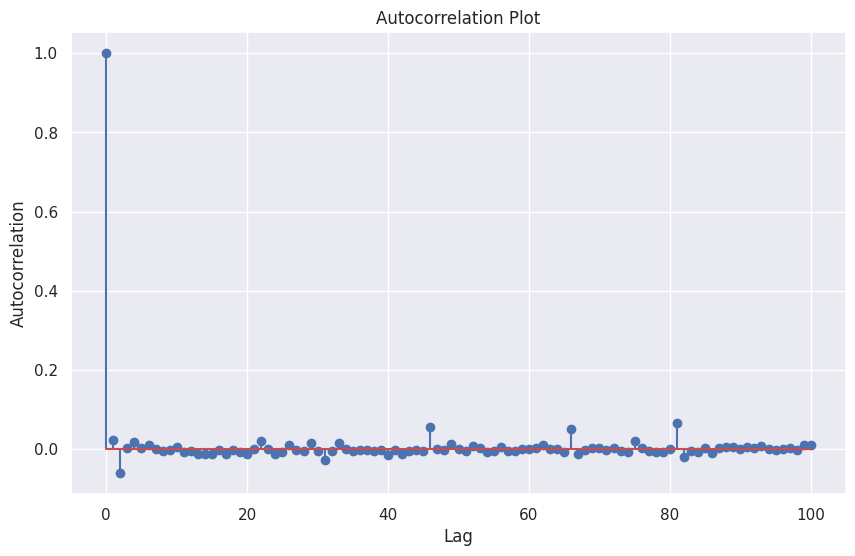

Quantile values saved to ./plots/s75/delay_quantiles.json
Saving plot to ./plots/s75/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays


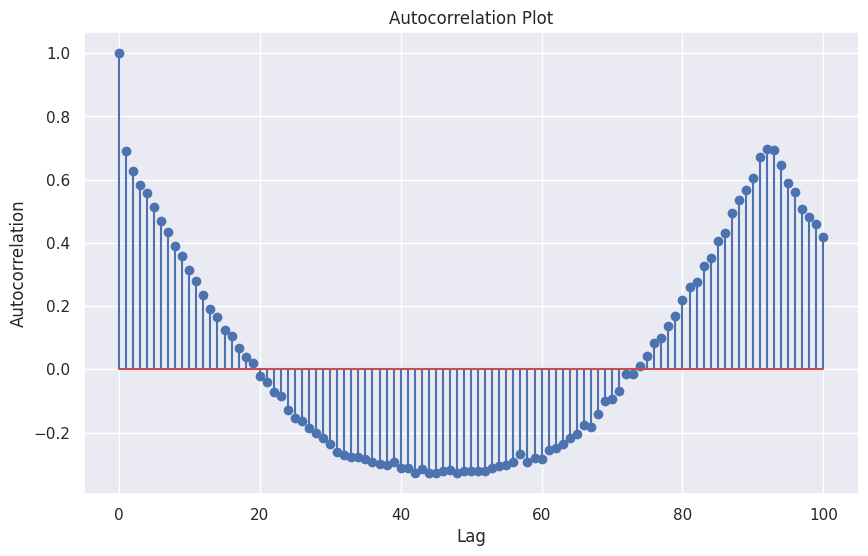

Quantile values saved to ./plots/s75/delay_quantiles.json
Saving plot to ./plots/s75/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays_wo_scheduling_delay


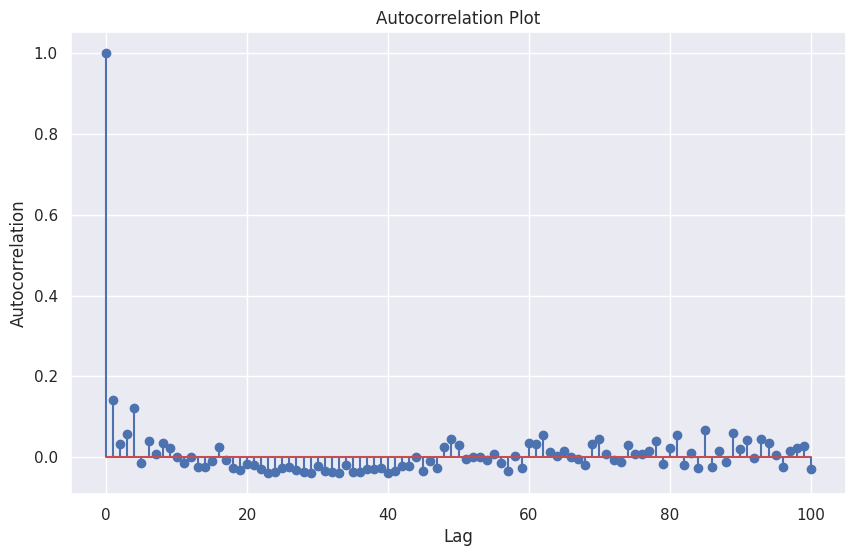

Quantile values saved to ./plots/s75/delay_quantiles.json
Saving plot to ./plots/s75/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delay


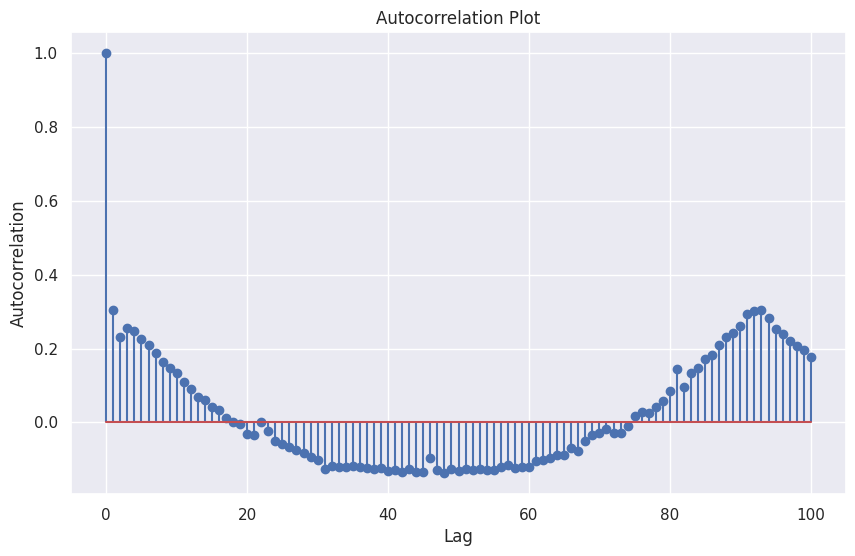

Quantile values saved to ./plots/s75/delay_quantiles.json
Saving plot to ./plots/s75/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delays_wo_scheduling_delay


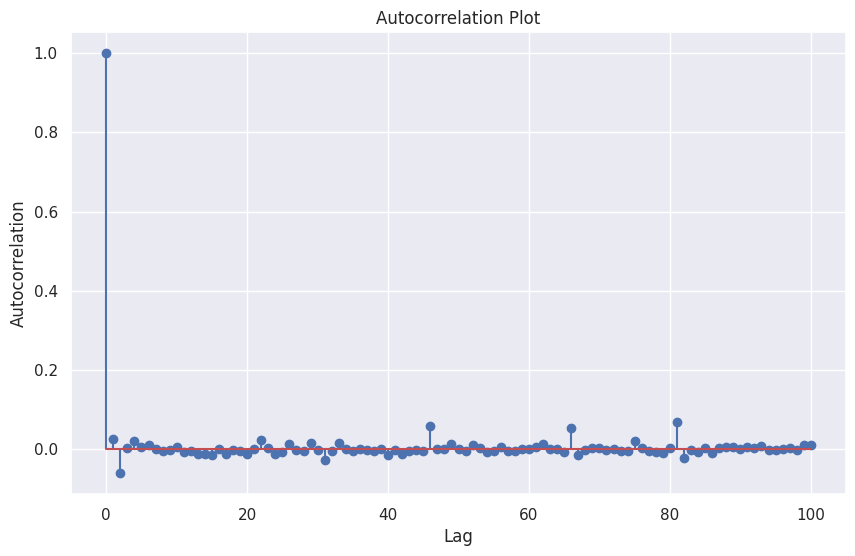

Quantile values saved to ./plots/s75/delay_quantiles.json
Saving plot to ./plots/s75/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for retx_delays


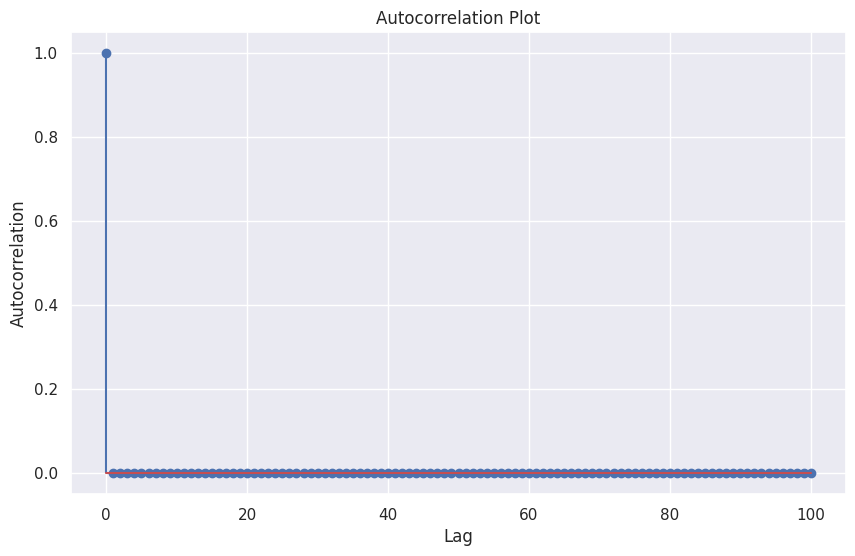

Quantile values saved to ./plots/s75/delay_quantiles.json
Saving plot to ./plots/s75/retx_delays_autocorrelation_plot.png
RNTIs in packets: ['b9a8']
2025-01-16 20:51:50.644 | ERROR    | decomp:get_tx_delay:166 - Packet 1863 phy.in_t or phy.in_t not present
2025-01-16 20:51:50.645 | ERROR    | decomp:get_tx_delay:166 - Packet 1863 phy.in_t or phy.in_t not present
2025-01-16 20:51:50.648 | ERROR    | decomp:get_tx_delay:166 - Packet 1699 phy.in_t or phy.in_t not present
2025-01-16 20:51:50.649 | ERROR    | decomp:get_tx_delay:166 - Packet 1699 phy.in_t or phy.in_t not present
2025-01-16 20:51:50.677 | ERROR    | decomp:get_tx_delay:166 - Packet 1863 phy.in_t or phy.in_t not present
2025-01-16 20:51:50.678 | ERROR    | decomp:get_tx_delay:166 - Packet 1863 phy.in_t or phy.in_t not present
2025-01-16 20:51:50.681 | ERROR    | decomp:get_tx_delay:166 - Packet 1699 phy.in_t or phy.in_t not present
2025-01-16 20:51:50.682 | ERROR    | decomp:get_tx_delay:166 - Packet 1699 phy.in_t or phy.in_t

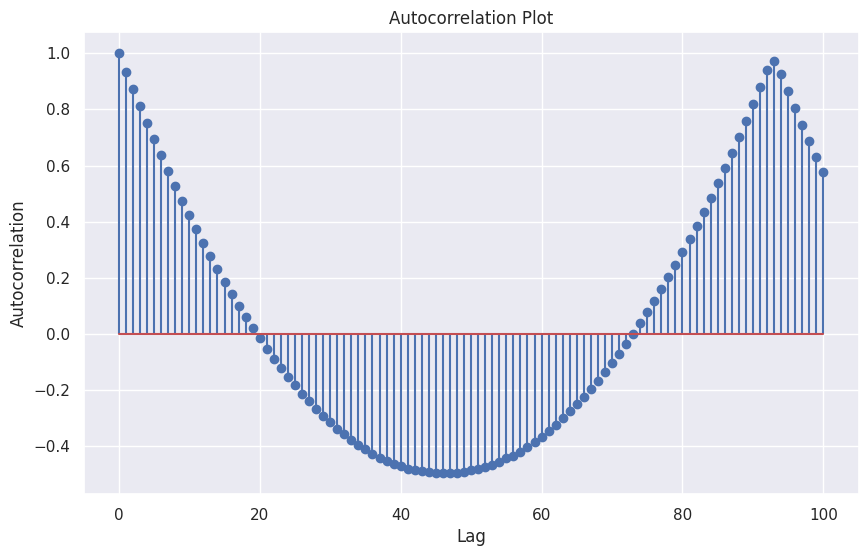

Quantile values saved to ./plots/s76/delay_quantiles.json
Saving plot to ./plots/s76/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for scheduling_delays


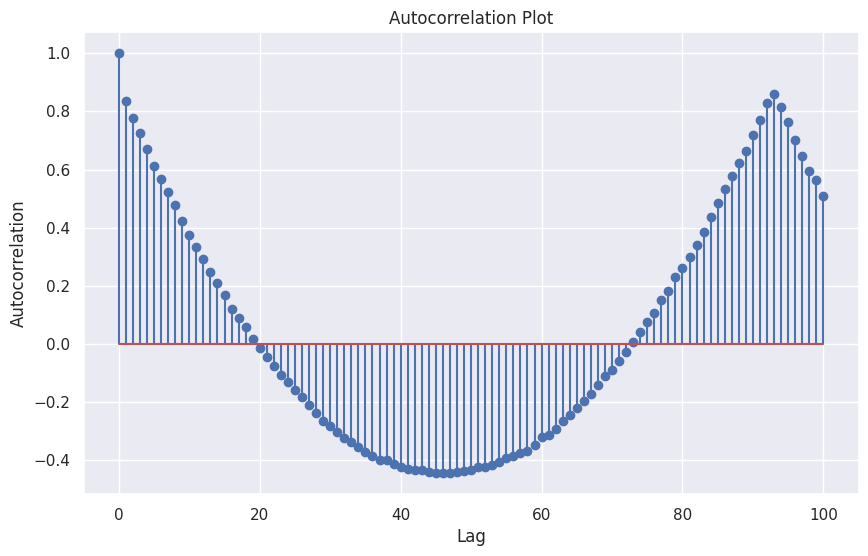

Quantile values saved to ./plots/s76/delay_quantiles.json
Saving plot to ./plots/s76/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays


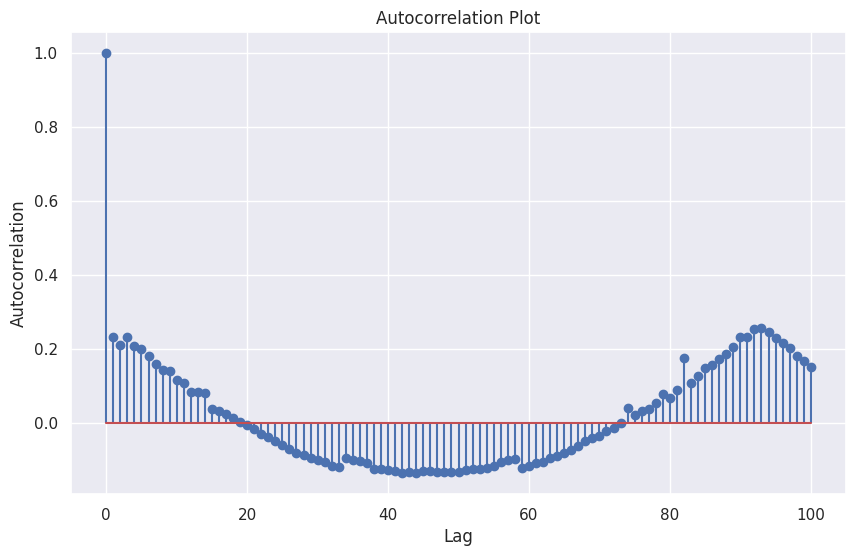

Quantile values saved to ./plots/s76/delay_quantiles.json
Saving plot to ./plots/s76/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_frame_alignment_delay


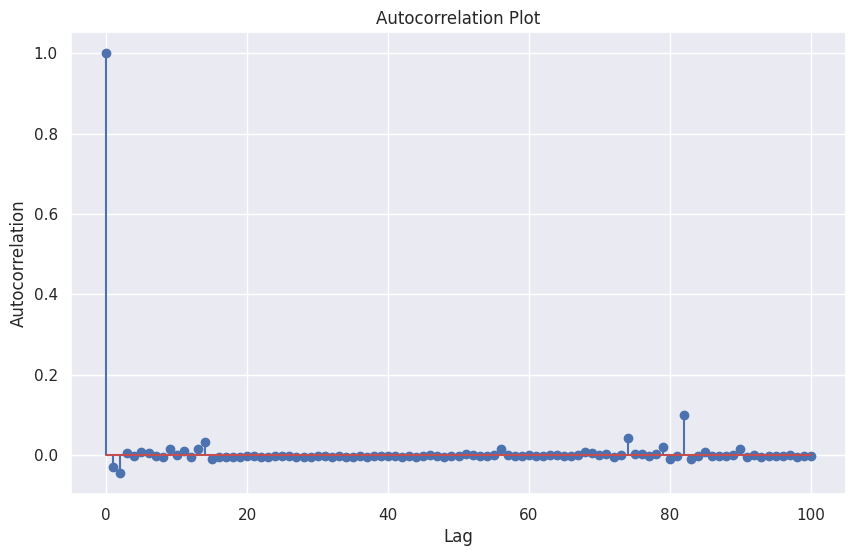

Quantile values saved to ./plots/s76/delay_quantiles.json
Saving plot to ./plots/s76/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_scheduling_delay


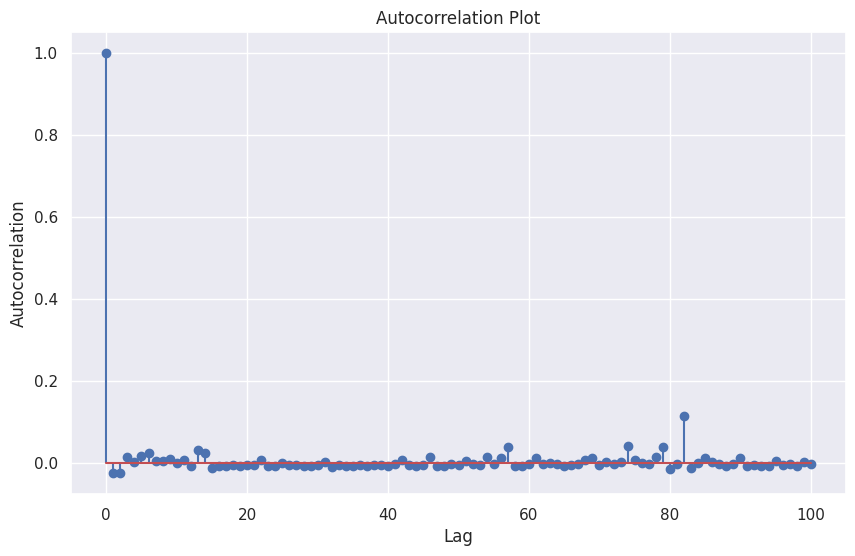

Quantile values saved to ./plots/s76/delay_quantiles.json
Saving plot to ./plots/s76/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays


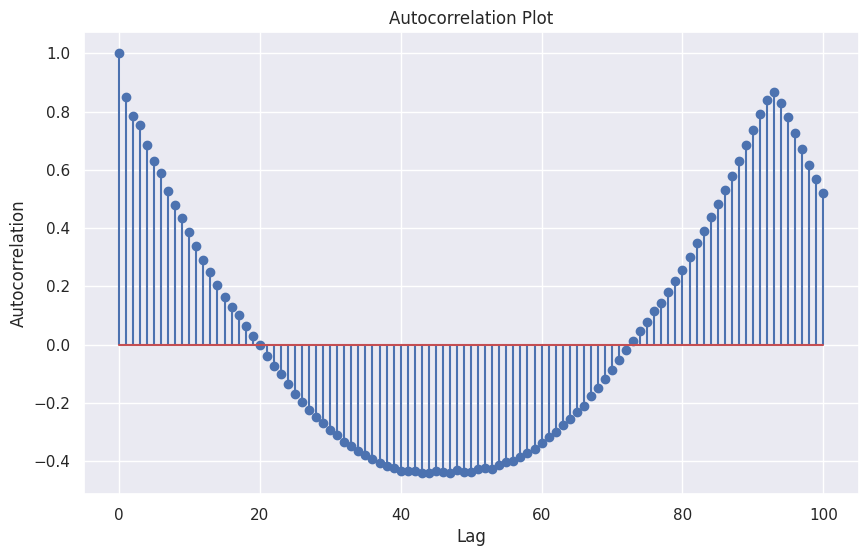

Quantile values saved to ./plots/s76/delay_quantiles.json
Saving plot to ./plots/s76/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays_wo_scheduling_delay


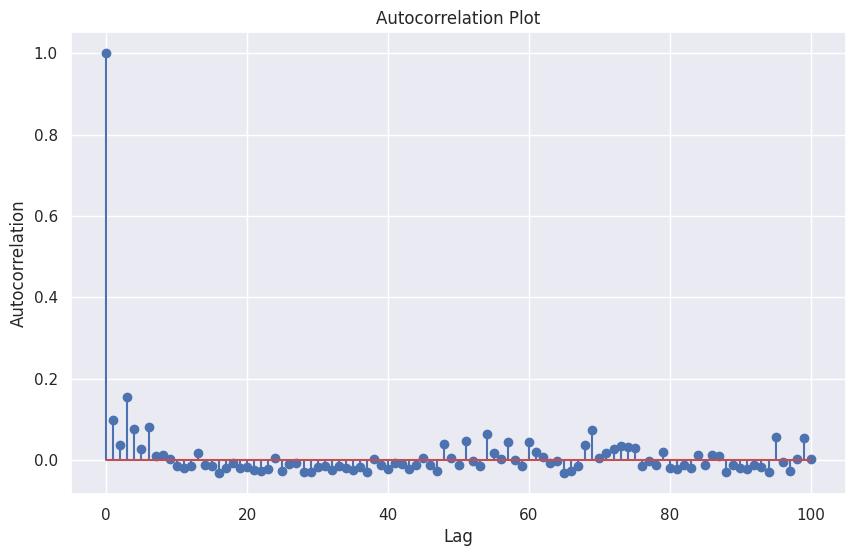

Quantile values saved to ./plots/s76/delay_quantiles.json
Saving plot to ./plots/s76/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delay


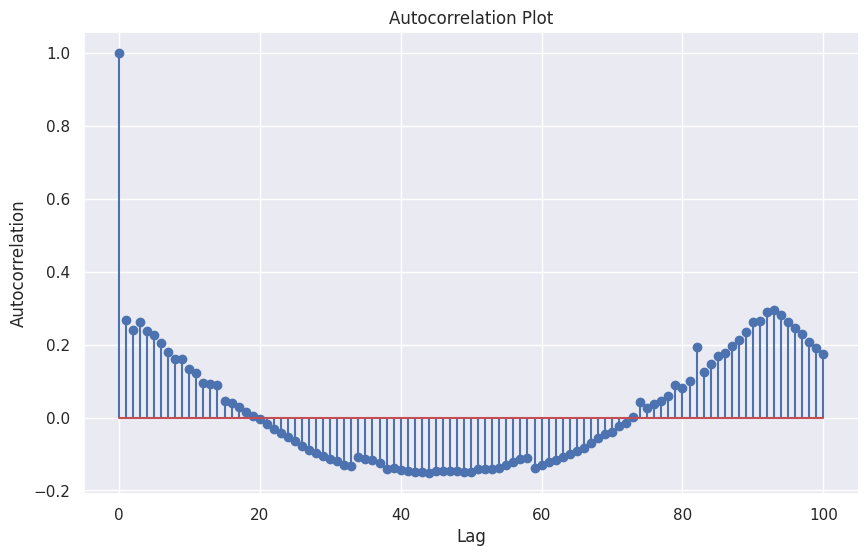

Quantile values saved to ./plots/s76/delay_quantiles.json
Saving plot to ./plots/s76/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delays_wo_scheduling_delay


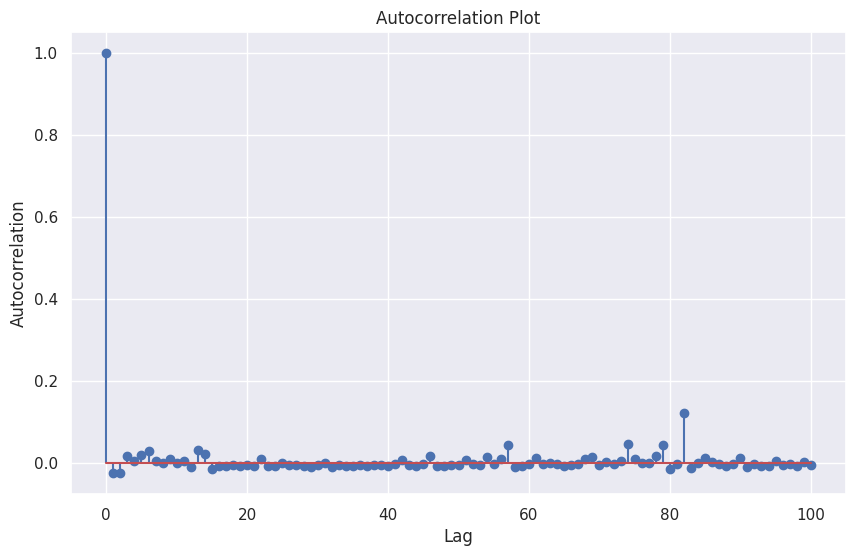

Quantile values saved to ./plots/s76/delay_quantiles.json
Saving plot to ./plots/s76/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for retx_delays


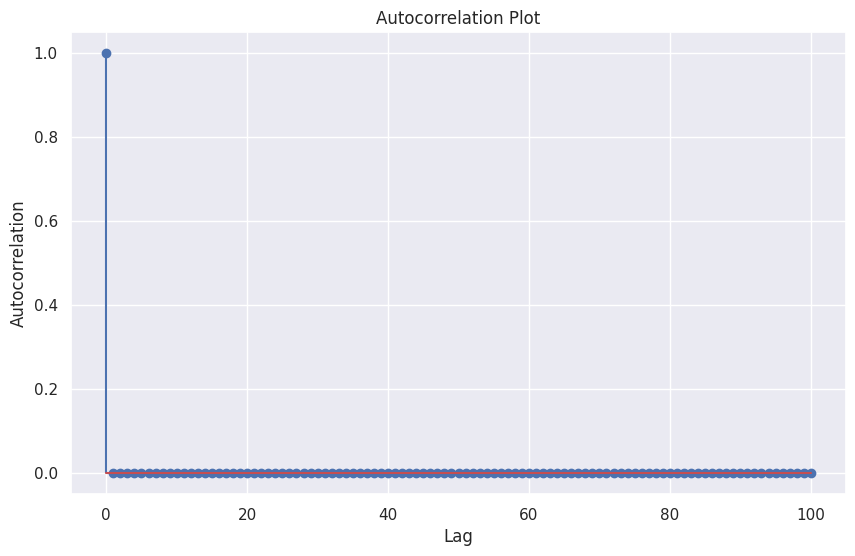

Quantile values saved to ./plots/s76/delay_quantiles.json
Saving plot to ./plots/s76/retx_delays_autocorrelation_plot.png
RNTIs in packets: ['5bc5']
2025-01-16 20:51:52.664 | ERROR    | decomp:get_tx_delay:166 - Packet 933 phy.in_t or phy.in_t not present
2025-01-16 20:51:52.665 | ERROR    | decomp:get_tx_delay:166 - Packet 933 phy.in_t or phy.in_t not present
2025-01-16 20:51:52.707 | ERROR    | decomp:get_tx_delay:166 - Packet 933 phy.in_t or phy.in_t not present
2025-01-16 20:51:52.708 | ERROR    | decomp:get_tx_delay:166 - Packet 933 phy.in_t or phy.in_t not present
Plotting autocorrelation for frame_alignment_delays


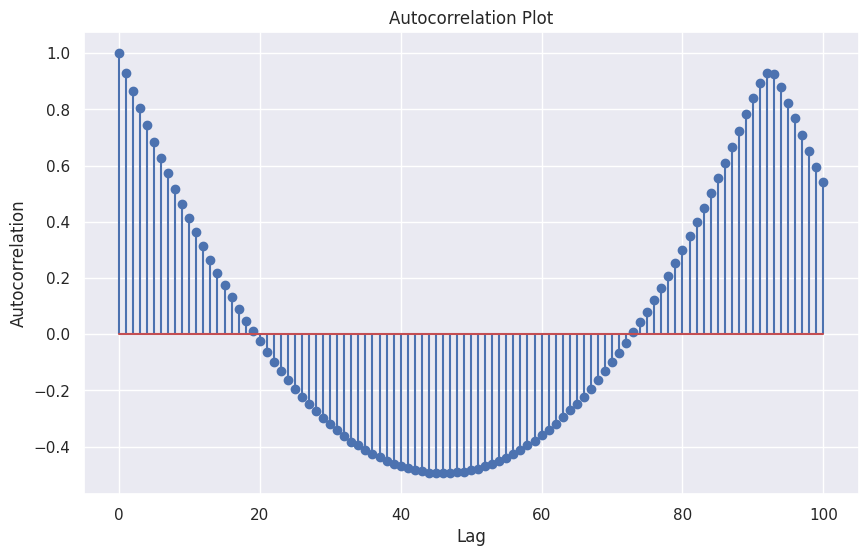

Quantile values saved to ./plots/s77/delay_quantiles.json
Saving plot to ./plots/s77/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for scheduling_delays


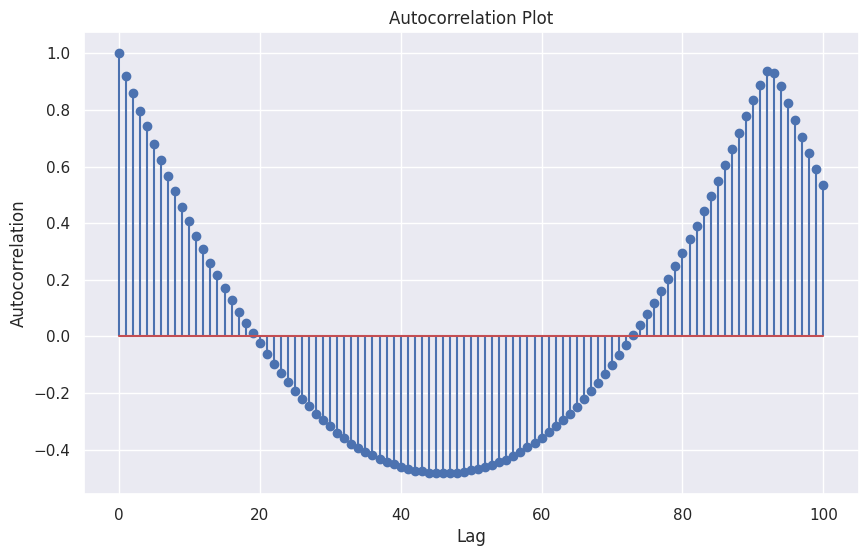

Quantile values saved to ./plots/s77/delay_quantiles.json
Saving plot to ./plots/s77/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays


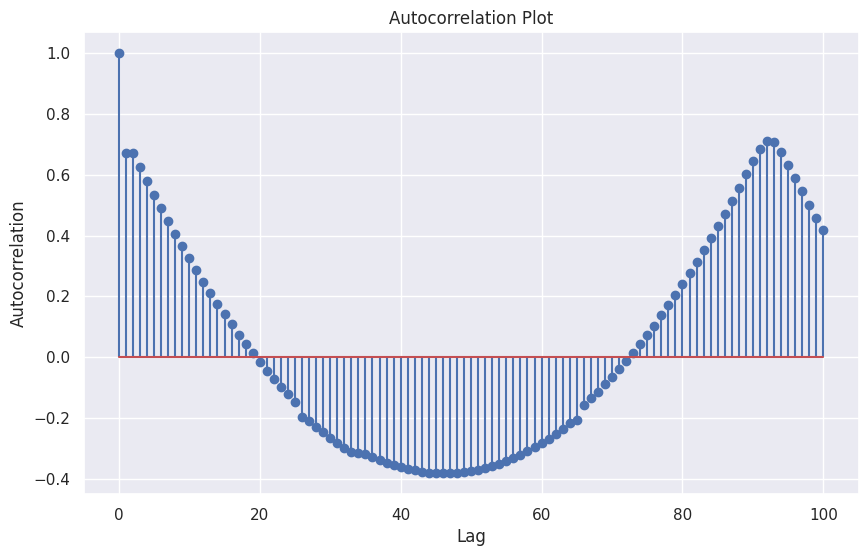

Quantile values saved to ./plots/s77/delay_quantiles.json
Saving plot to ./plots/s77/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_frame_alignment_delay


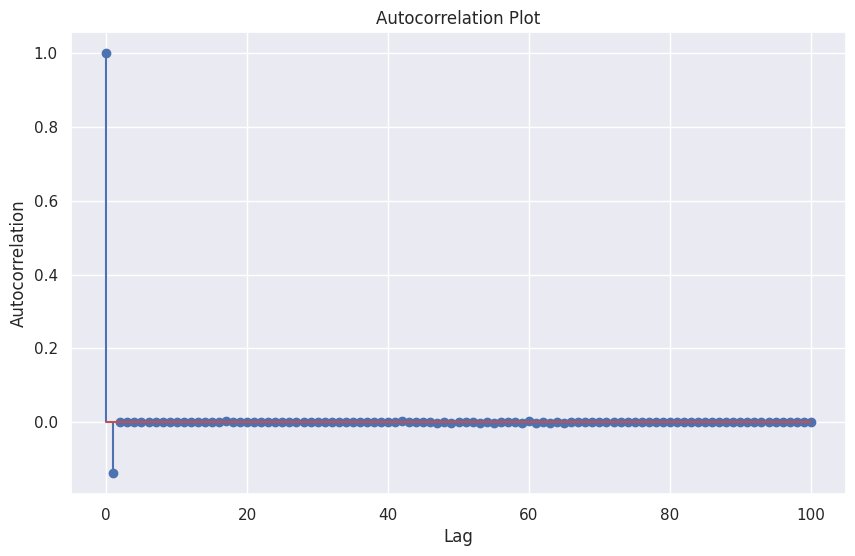

Quantile values saved to ./plots/s77/delay_quantiles.json
Saving plot to ./plots/s77/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for ran_delays_wo_scheduling_delay


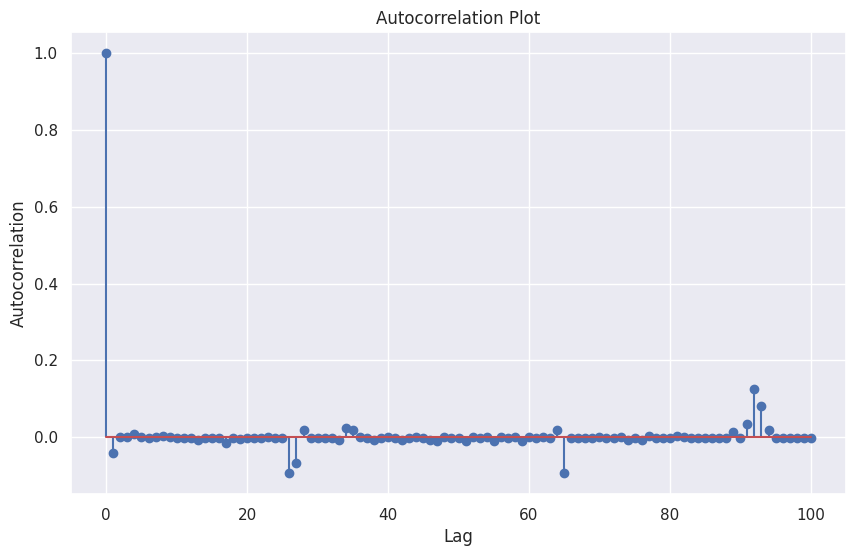

Quantile values saved to ./plots/s77/delay_quantiles.json
Saving plot to ./plots/s77/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays


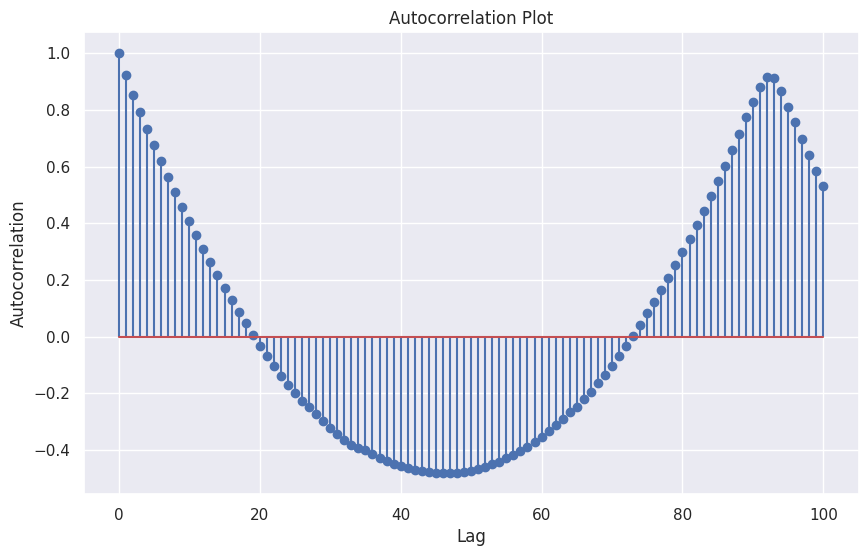

Quantile values saved to ./plots/s77/delay_quantiles.json
Saving plot to ./plots/s77/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for queueing_delays_wo_scheduling_delay


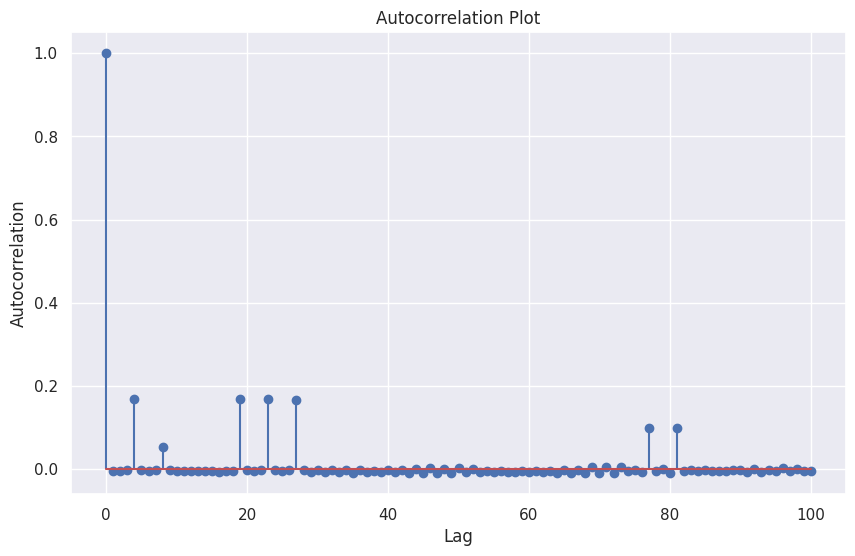

Quantile values saved to ./plots/s77/delay_quantiles.json
Saving plot to ./plots/s77/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delay


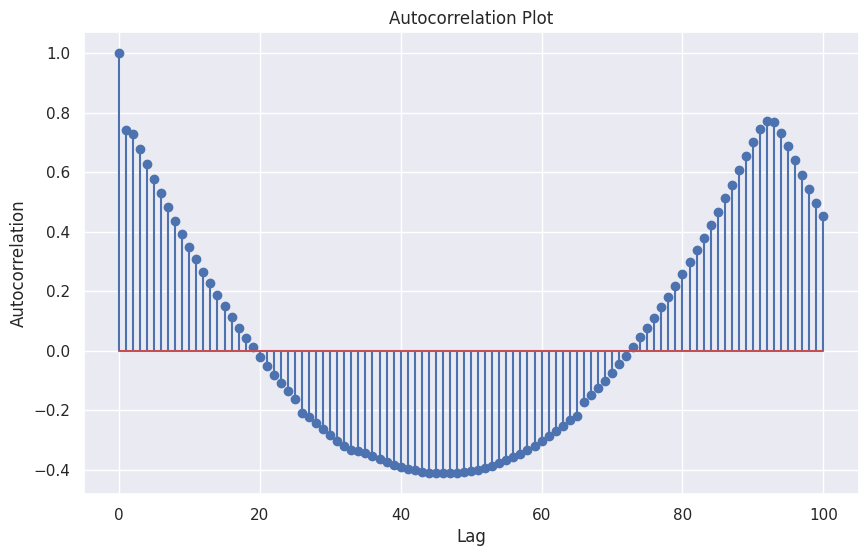

Quantile values saved to ./plots/s77/delay_quantiles.json
Saving plot to ./plots/s77/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for segmentation_delays_wo_scheduling_delay


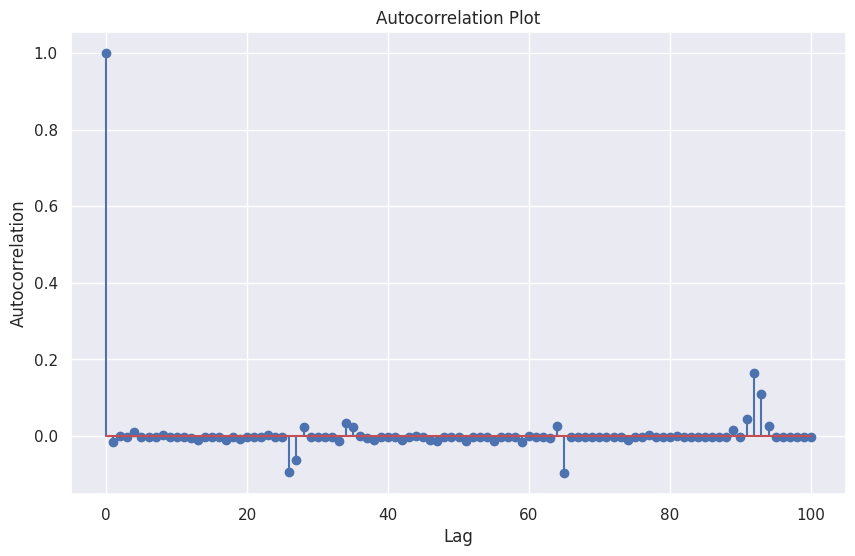

Quantile values saved to ./plots/s77/delay_quantiles.json
Saving plot to ./plots/s77/retx_delays_autocorrelation_plot.png
Plotting autocorrelation for retx_delays


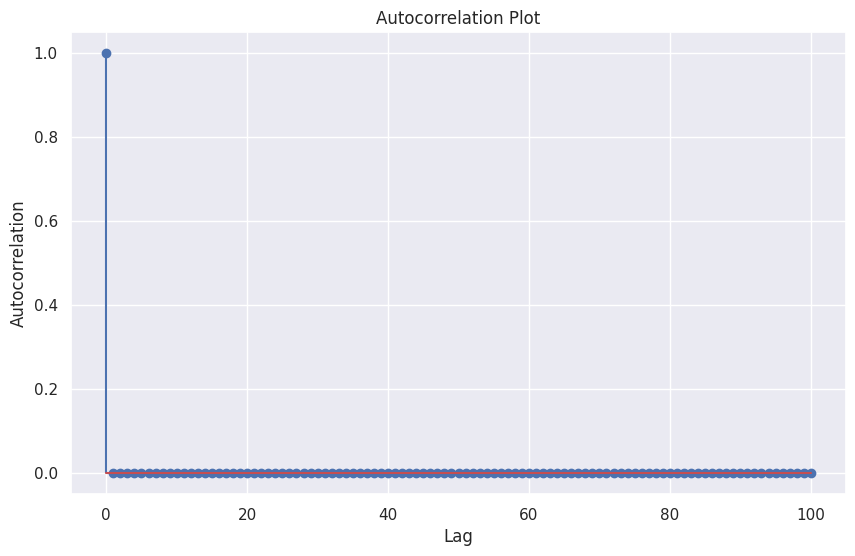

Quantile values saved to ./plots/s77/delay_quantiles.json
Saving plot to ./plots/s77/retx_delays_autocorrelation_plot.png


In [ ]:
for label in MEAS_LABELS:
    if IMPORT_FROM_JSON==False:
        # packet analyzer
        analyzer = ULPacketAnalyzer(paths[label]['DB_FILE'])
        uids_arr = range(analyzer.first_ueipid, analyzer.last_ueipid+1)
        packets = analyzer.figure_packettx_from_ueipids(uids_arr)
        packets_rnti_set = set([item['rlc.attempts'][0]['rnti'] for item in packets if item['rlc.attempts'][0]['rnti']==list(packets_rnti_set)[0] or item['rlc.attempts'][0]['rnti']==None])
        print(f'RNTIs in packets: {list(packets_rnti_set)}')
        # sched analyzer
        sched_analyzer = ULSchedulingAnalyzer(
            total_prbs_num = 106, 
            symbols_per_slot = 14, 
            slots_per_frame = 20, 
            slots_duration_ms = 0.5, 
            scheduling_map_num_integers = 4,
            max_num_frames=100,
            db_addr = paths[label]['DB_FILE']
        )
        
        begin_ts = sched_analyzer.first_ts
        end_ts = sched_analyzer.last_ts
        sched_arr = sched_analyzer.find_resource_schedules_from_ts(begin_ts, end_ts)
        #sched_sorted_dict = SortedDict({sched['decision_ts']: sched for sched in sched_arr})
        sched_sorted_dict = SortedDict({sched['schedule_ts']: sched for sched in sched_arr 
                                        if sched['cause'].get('rnti')==list(packets_rnti_set)[0]
                                        or sched['cause'].get('rnti')==None})

        bsrupd_arr = sched_analyzer.find_bsr_upd_from_ts(begin_ts, end_ts)
        sr_tx_arr = sched_analyzer.find_sr_tx_from_ts(begin_ts, end_ts)
        bsr_tx_arr = sched_analyzer.find_bsr_tx_from_ts(begin_ts, end_ts)
        sr_bsr_tx_sorted_list = SortedList([sr_tx['timestamp'] for sr_tx in sr_tx_arr]+[bsr_tx['timestamp'] for bsr_tx in bsr_tx_arr])
        
        chan_analyzer = ULChannelAnalyzer(paths[label]['DB_FILE'])
        begin_ts = chan_analyzer.first_ts
        end_ts = chan_analyzer.last_ts
        WINDOW_LEN_SECONDS = 2
        mcs_arr_all = chan_analyzer.find_mcs_from_ts(begin_ts,end_ts)
        tb_arr = chan_analyzer.find_mac_attempts_from_ts(begin_ts,end_ts)
        set_rnti = set([item['rnti'] for item in mcs_arr_all])
        # filter entries with rnti list(packets_rnti_set)[0] 
        if list(packets_rnti_set)[0]!=None:
            mcs_arr = [mcs for mcs in mcs_arr_all if mcs['rnti']==list(packets_rnti_set)[0]]
        mcs_sorted_dict = SortedDict({mcs['timestamp']: mcs for mcs in mcs_arr})

        #print(f'RNTIs in channel: {list(set_rnti)}')
    else:
        packets = read_json(paths[label]['DATA_DIR']+'packets.json')
        sr_tx_arr = read_json(paths[label]['DATA_DIR']+'sr_tx.json')
        bsr_tx_arr = read_json(paths[label]['DATA_DIR']+'bsr_tx.json')
        bsrupd_arr = read_json(paths[label]['DATA_DIR']+'bsr_upd.json')
        bsrupd_sorted_dict = SortedDict({bsrupd['timestamp']: bsrupd for bsrupd in bsrupd_arr})
        sr_bsr_tx_sorted_list = SortedList([sr_tx['timestamp'] for sr_tx in sr_tx_arr]+[bsr_tx['timestamp'] for bsr_tx in bsr_tx_arr])
        sched_arr = read_json(paths[label]['DATA_DIR']+'sched.json')
        #sched_sorted_dict = SortedDict({sched['decision_ts']: sched for sched in sched_arr})
        packets_rnti_set = set([item['rlc.attempts'][0]['rnti'] for item in packets if item['rlc.attempts'][0]['rnti']!=None])
        sched_sorted_dict = SortedDict({sched['schedule_ts']: sched for sched in sched_arr 
                                    if sched['cause'].get('rnti')==list(packets_rnti_set)[0]
                                    or sched['cause'].get('rnti')==None})
        print(f'RNTIs in packets: {list(packets_rnti_set)}')
        mcs_arr_all = read_json(paths[label]['DATA_DIR']+'mcs.json')
        tb_arr = read_json(paths[label]['DATA_DIR']+'tb.json')
        set_rnti = set([item['rnti'] for item in mcs_arr_all])
        # filter entries with rnti list(packets_rnti_set)[0] 
        if list(packets_rnti_set)[0]!=None:
            mcs_arr = [mcs for mcs in mcs_arr_all if mcs['rnti']==list(packets_rnti_set)[0]]
        else:
            mcs_arr = mcs_arr_all
        mcs_sorted_dict = SortedDict({mcs['timestamp']: mcs for mcs in mcs_arr})
        #print(f'RNTIs in channel: {list(set_rnti)}')
        # send_ts = analyzer.nlmt_df['timestamps.client.send.wall'].to_numpy()
    # send_ts = (send_ts)/1e6
    # receive_ts = analyzer.nlmt_df['timestamps.server.receive.wall'].to_numpy()
    # receive_ts = (receive_ts)/1e6
    # idt = (send_ts[1:-1]-send_ts[0:-2])
    # e2e_delays = receive_ts-send_ts

    idt = np.array(list({packets[ind]['id']: packets[ind]['ip.in_t']-packets[ind-1]['ip.in_t'] for ind in range(1, len(packets)) if packets[ind]['ip.in_t']!=None and  packets[ind-1]['ip.in_t']!=None}.values()))
    frame_alignment_delays = np.array(list({packet['id']: get_frame_alignment_delay(packet, sr_bsr_tx_sorted_list, slots_per_frame=20, slots_duration_ms=0.5) for packet in packets if get_frame_alignment_delay(packet, sr_bsr_tx_sorted_list, slots_per_frame=20, slots_duration_ms=0.5)!=None}.values()))
    scheduling_delays = np.array(list({packet['id']: get_scheduling_delay(packet, sched_sorted_dict, slots_per_frame=20, slots_duration_ms=0.5) for packet in packets if get_scheduling_delay(packet, sched_sorted_dict, slots_per_frame=20, slots_duration_ms=0.5)!=None}.values()))
    ran_delays = np.array(list({packet['id']: get_ran_delay(packet) for packet in packets if get_ran_delay(packet)!=None}.values()))
    ran_delays_wo_frame_alignment_delay = np.array(list({packet['id']: get_ran_delay_wo_frame_alignment_delay(packet, sr_bsr_tx_sorted_list, slots_per_frame=20, slots_duration_ms=0.5) for packet in packets if get_ran_delay_wo_frame_alignment_delay(packet, sr_bsr_tx_sorted_list, slots_per_frame=20, slots_duration_ms=0.5)!=None}.values()))
    ran_delays_wo_scheduling_delay = np.array(list({packet['id']: get_ran_delay_wo_scheduling_delay(packet, sched_sorted_dict, slots_per_frame=20, slots_duration_ms=0.5) for packet in packets if get_ran_delay_wo_scheduling_delay(packet, sched_sorted_dict, slots_per_frame=20, slots_duration_ms=0.5)!=None}.values()))
    queueing_delays = np.array(list({packet['id']: get_queueing_delay(packet) for packet in packets if get_queueing_delay(packet)!=None}.values()))
    queueing_delays_wo_scheduling_delay = np.array(list({packet['id']: get_queueing_delay_wo_scheduling_delay(packet, sched_sorted_dict, slots_per_frame=20, slots_duration_ms=0.5) for packet in packets if get_queueing_delay_wo_scheduling_delay(packet, sched_sorted_dict, slots_per_frame=20, slots_duration_ms=0.5)!=None}.values()))
    segmentation_delay = np.array(list({packet['id']: get_segmentation_delay(packet) for packet in packets if get_segmentation_delay(packet)!=None}.values()))
    segmentation_delays_wo_scheduling_delay = np.array(list({packet['id']: get_segmentation_delay_wo_scheduling_delay(packet, sched_sorted_dict, slots_per_frame=20, slots_duration_ms=0.5) for packet in packets if get_segmentation_delay_wo_scheduling_delay(packet, sched_sorted_dict, slots_per_frame=20, slots_duration_ms=0.5)!=None}.values()))
    segments = np.array(list({packet['id']: get_segments(packet) for packet in packets if get_segments(packet)!=None}.values()))
    retx_delays = np.array(list({packet['id']: get_retx_delay(packet) for packet in packets if get_retx_delay(packet)!=None}.values()))
    mcss = np.array(list({packet['id']: get_mcs(packet, mcs_sorted_dict, slots_per_frame=20, slots_duration_ms=0.5) for packet in packets if get_mcs(packet, mcs_sorted_dict, slots_per_frame=20, slots_duration_ms=0.5)!=None}.values()))

    # Define the list of delay variables
    delay_variables = [
        'frame_alignment_delays',
        'scheduling_delays',
        'ran_delays',
        'ran_delays_wo_frame_alignment_delay',
        'ran_delays_wo_scheduling_delay',
        'queueing_delays',
        'queueing_delays_wo_scheduling_delay',
        'segmentation_delay',
        'segmentation_delays_wo_scheduling_delay',
        'retx_delays'
    ]

    # Plot autocorrelation for each delay variable
    for delay_var in delay_variables:
        data = globals()[delay_var]
        # print(f"Plotting autocorrelation for {delay_var}")
        # plot_autocorrelation(data, max_lag=100)
        # Save the plot
        # Define the quantiles
        quantiles = [0.50, 0.9, 0.99, 0.999, 0.9999]

        # Dictionary to store the quantile values for each delay variable
        quantile_values = {}

        # Calculate and store quantile values for each delay variable
        for delay_var in delay_variables:
            data = globals()[delay_var]
            quantile_values[delay_var] = {q: np.quantile(data, q) for q in quantiles}

        # Save the quantile values to a JSON file
        quantile_file_path = os.path.join(paths[label]['PLOTS_DIR'], 'delay_quantiles.json')
        with open(quantile_file_path, 'w') as f:
            json.dump(quantile_values, f, indent=4)

        print(f"Quantile values saved to {quantile_file_path}")
        # print(f"Saving plot to {paths[label]['PLOTS_DIR']}{delay_var}_autocorrelation_plot.png")
    # plt.savefig(f"{PLOTS_DIR}{delay_var}_autocorrelation_plot.png", dpi=300, bbox_inches='tight')

# Read quantile values from json file

In [ ]:
# Read the quantile values from the JSON file
for label in MEAS_LABELS:
    quantile_file_path = os.path.join(paths[label]['PLOTS_DIR'], 'delay_quantiles.json')
    with open(quantile_file_path, 'r') as f:
        quantile_values = json.load(f)

    # Create a dictionary for the quantiles
    quant = {str(q): quantile_values['ran_delays'][str(q)] for q in [0.50, 0.9, 0.99, 0.999, 0.9999]}

    # Display the quantile dictionary
    print(f"Quantile values for {label}: {quant}")